In [1]:
!python -m pip install pyyaml==5.1
import sys, os, distutils.core
# Note: This is a faster way to install detectron2 in Colab, but it does not include all functionalities.
# See https://detectron2.readthedocs.io/tutorials/install.html for full installation instructions
!git clone 'https://github.com/facebookresearch/detectron2'
dist = distutils.core.run_setup("./detectron2/setup.py")
!python -m pip install {' '.join([f"'{x}'" for x in dist.install_requires])}
sys.path.insert(0, os.path.abspath('./detectron2'))

# Properly install detectron2. (Please do not install twice in both ways)
# !python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.2/274.2 KB 3.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for pyyaml: filename=PyYAML-5.1-cp39-cp39-linux_x86_64.whl size=44090 sha256=cab8ee534486342eeb8def85db098106616a922a16839ca866d96850cbccb77b
  Stored in directory: /root/.cache/pip/wheels/68/be/8f/b6c454cd264e0b349b47f8ee00755511f277618af9e5dae20d
Successfully built pyyaml
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 6.0
    Uninstalling PyYAML-6.0:
      Successfully uninstalled PyYAML-6.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
dask 2022.2.1 requires pyyaml>=5.3.1, but you have pyyaml 5.1 which is incompatible.
Cloning into 'detectron2'...
remote: Enumerating objects: 14913, done.
remote: Tot

No CUDA runtime is found, using CUDA_HOME='/usr/local/cuda'


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 KB 5.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 KB 4.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 KB 19.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 38.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 KB 13.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for fvcore: filename=fvcore-0.1.5.post20221221-py3-none-any.whl size=61431 sha256=fce17e8dec023034e22fa4efbd567c21bdb9877ef457efa6b593b5ba29e708f2
  Stored in directory: /root/.cache/pip/wheels/83/42/02/66178d16e5c44dc26d309931834956baeda371956e86fbd876
  Created wheel for antlr4-python3-runtime: filename=antlr4_python3_runtime-4.9.3-py3-none-any.whl size=144575 sha256=0aa9f49268f0d1e6b61008c760b393

In [2]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2022 NVIDIA Corporation
Built on Wed_Sep_21_10:33:58_PDT_2022
Cuda compilation tools, release 11.8, V11.8.89
Build cuda_11.8.r11.8/compiler.31833905_0
torch:  1.13 ; cuda:  cu116
detectron2: 0.6


In [3]:
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.data import MetadataCatalog
from detectron2.utils.visualizer import ColorMode, Visualizer
from detectron2 import model_zoo

import cv2
import numpy
import matplotlib.pyplot as plt
from pprint import pprint

from google.colab.patches import cv2_imshow

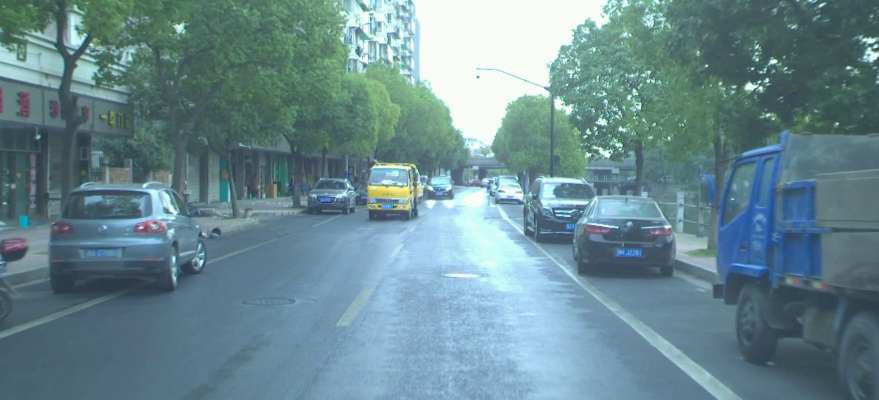

In [36]:
image = cv2.imread('image_1_2018-10-31-06-55-01_2018-10-31-07-00-50-232.jpg')
cv2_imshow(image)

In [5]:
cfg = get_cfg()
cfg.MODEL.DEVICE = "cpu"

cfg.merge_from_file(model_zoo.get_config_file("COCO-PanopticSegmentation/panoptic_fpn_R_101_3x.yaml"))
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-PanopticSegmentation/panoptic_fpn_R_101_3x.yaml")

panoptic segmentations


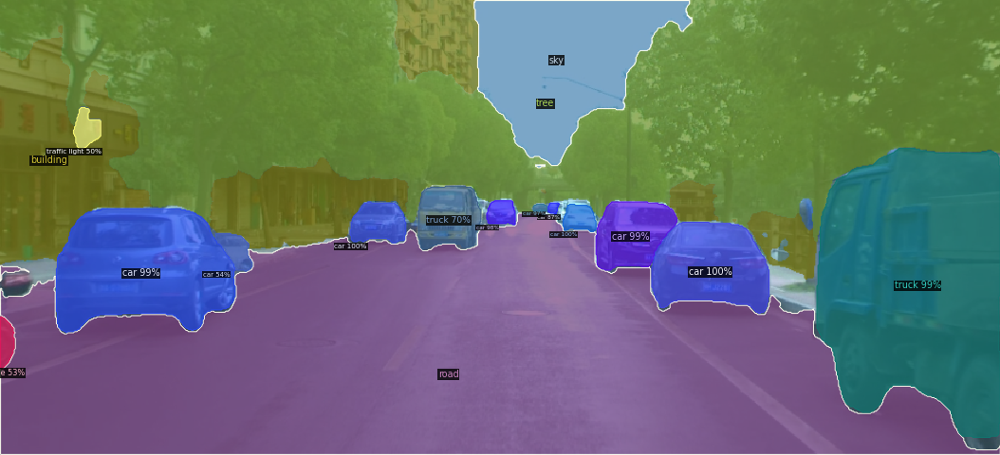

instance predictions


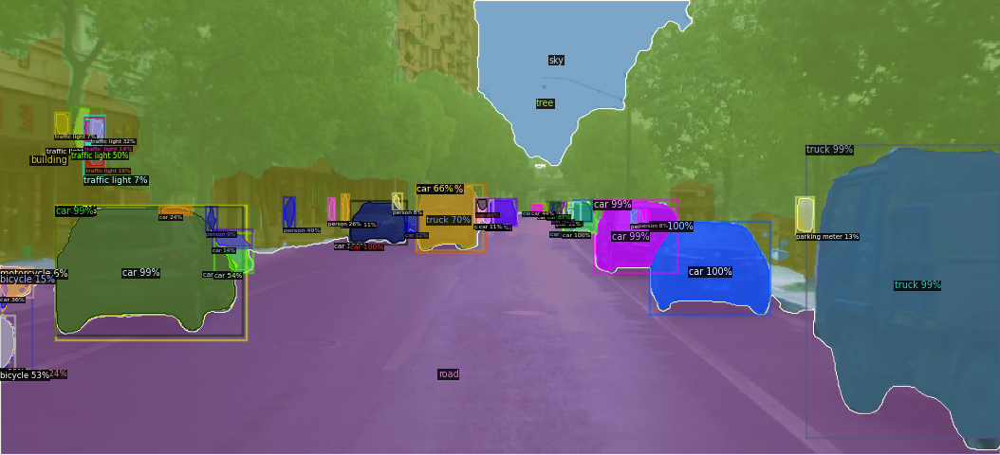

(tensor([[15, 15, 15,  ..., 15, 15, 15],
         [15, 15, 15,  ..., 15, 15, 15],
         [15, 15, 15,  ..., 15, 15, 15],
         ...,
         [14, 14, 14,  ..., 14, 14, 14],
         [14, 14, 14,  ..., 14, 14, 14],
         [14, 14, 14,  ..., 14, 14, 14]], dtype=torch.int32),
 [{'id': 1,
   'isthing': True,
   'score': 0.9977814555168152,
   'category_id': 2,
   'instance_id': 0,
   'area': 6561.0},
  {'id': 2,
   'isthing': True,
   'score': 0.9959344863891602,
   'category_id': 2,
   'instance_id': 1,
   'area': 1477.0},
  {'id': 3,
   'isthing': True,
   'score': 0.9950982928276062,
   'category_id': 2,
   'instance_id': 2,
   'area': 594.0},
  {'id': 4,
   'isthing': True,
   'score': 0.9900480508804321,
   'category_id': 2,
   'instance_id': 3,
   'area': 3336.0},
  {'id': 5,
   'isthing': True,
   'score': 0.9876614809036255,
   'category_id': 2,
   'instance_id': 4,
   'area': 13658.0},
  {'id': 6,
   'isthing': True,
   'score': 0.9854550361633301,
   'category_id': 7,
   '

In [23]:
predictor = DefaultPredictor(cfg)

def panoptic_and_instance_segmentation(image):
  panoptic_seg, segments_info = predictor(image)["panoptic_seg"]

  v = Visualizer(image[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
  print('panoptic segmentations')
  out = v.draw_panoptic_seg_predictions(panoptic_seg.to("cpu"), segments_info)
  cv2_imshow(out.get_image()[:, :, ::-1])

  print('instance predictions')
  out = v.draw_instance_predictions(predictor(image)["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])

  return panoptic_seg, segments_info

panoptic_and_instance_segmentation(image)

contour :  0
mask


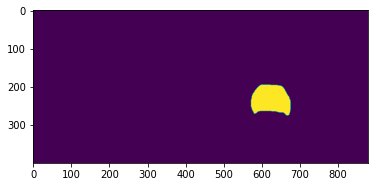

contour :  1
mask


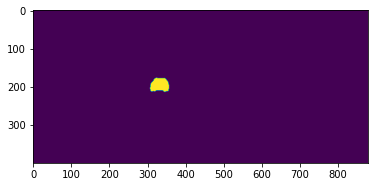

contour :  2
mask


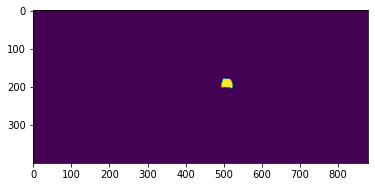

contour :  3
mask


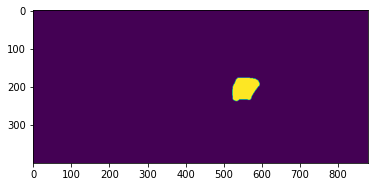

contour :  4
mask


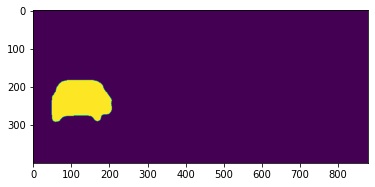

contour :  5
mask


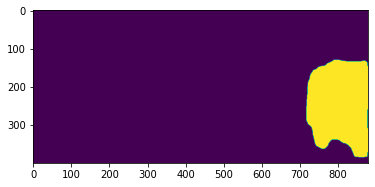

contour :  6
mask


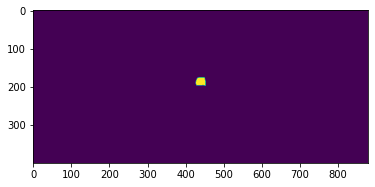

contour :  7
mask


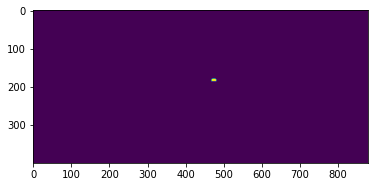

contour :  8
mask


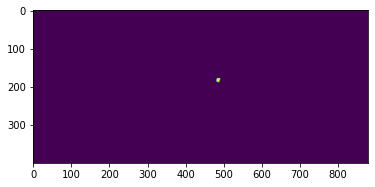

contour :  9
mask


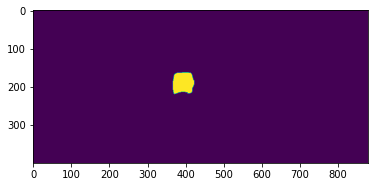

contour :  10
mask


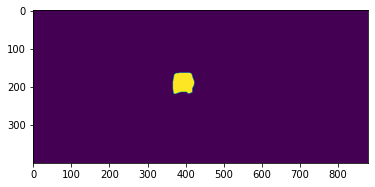

contour :  11
mask


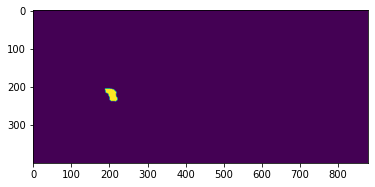

contour :  12
mask


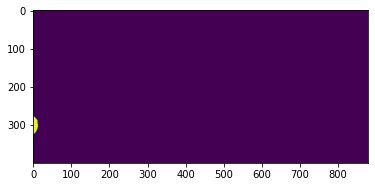

contour :  13
mask


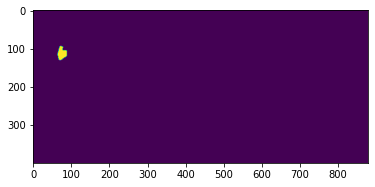

contour :  14
mask


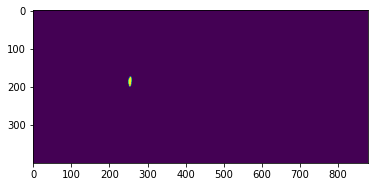

contour :  15
mask


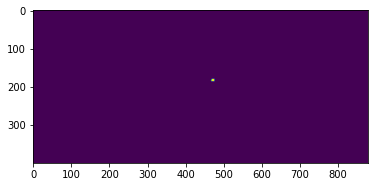

contour :  16
mask


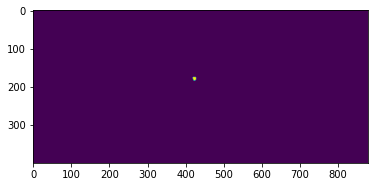

contour :  17
mask


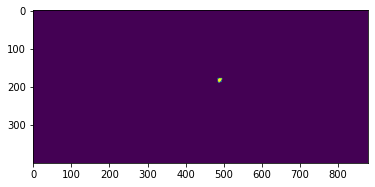

contour :  18
mask


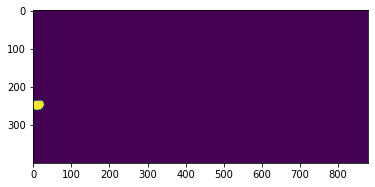

contour :  19
mask


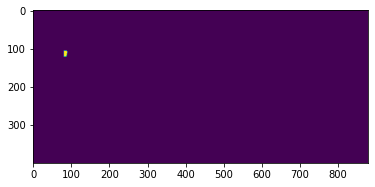

contour :  20
mask


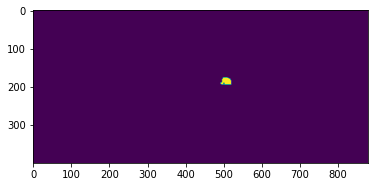

contour :  21
mask


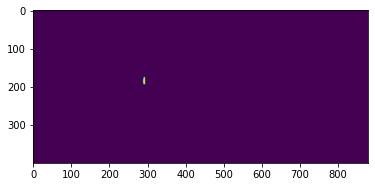

contour :  22
mask


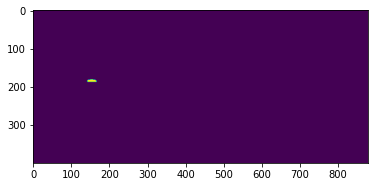

contour :  23
mask


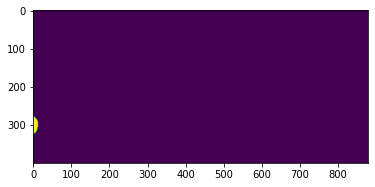

contour :  24
mask


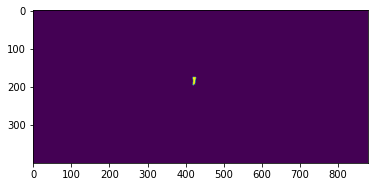

contour :  25
mask


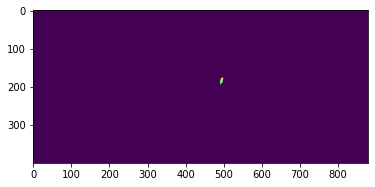

contour :  26
mask


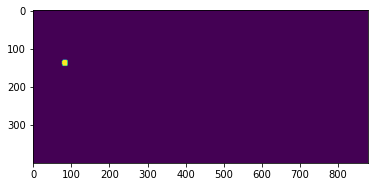

contour :  27
mask


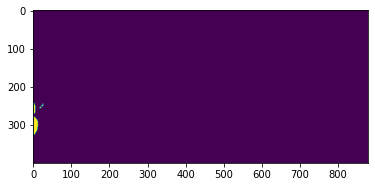

contour :  28
mask


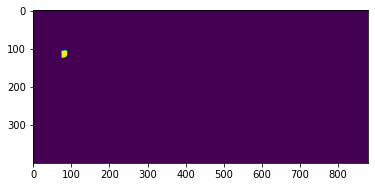

contour :  29
mask


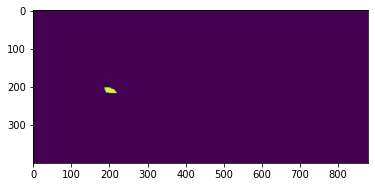

contour :  30
mask


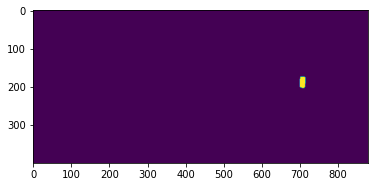

contour :  31
mask


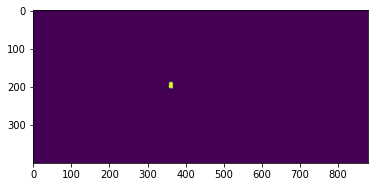

contour :  32
mask


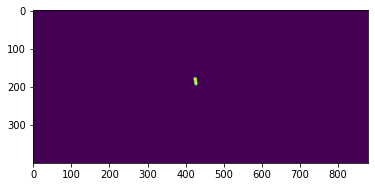

contour :  33
mask


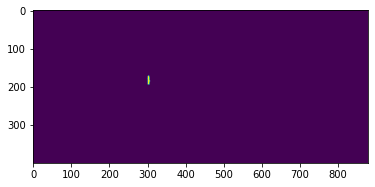

contour :  34
mask


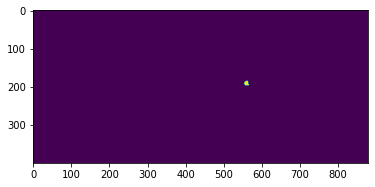

contour :  35
mask


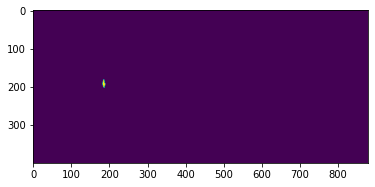

contour :  36
mask


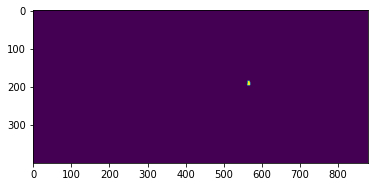

contour :  37
mask


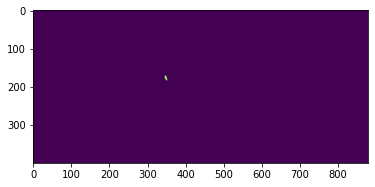

contour :  38
mask


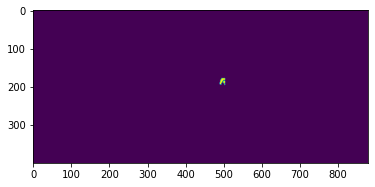

contour :  39
mask


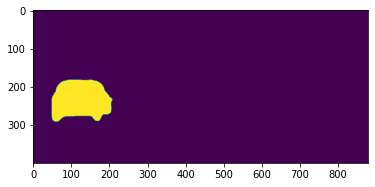

contour :  40
mask


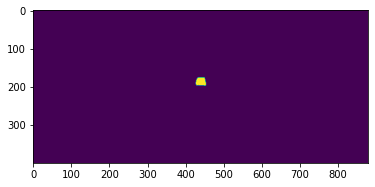

contour :  41
mask


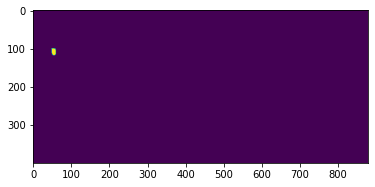

contour :  42
mask


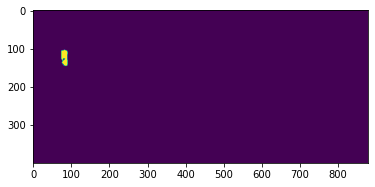

contour :  43
mask


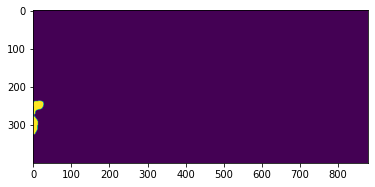

[array([[[599, 195]],
 
        [[598, 196]],
 
        [[597, 196]],
 
        [[596, 196]],
 
        [[595, 197]],
 
        [[594, 198]],
 
        [[593, 198]],
 
        [[592, 199]],
 
        [[591, 200]],
 
        [[590, 201]],
 
        [[589, 202]],
 
        [[588, 203]],
 
        [[587, 204]],
 
        [[586, 205]],
 
        [[586, 206]],
 
        [[585, 207]],
 
        [[584, 208]],
 
        [[583, 209]],
 
        [[582, 210]],
 
        [[582, 211]],
 
        [[581, 212]],
 
        [[581, 213]],
 
        [[580, 214]],
 
        [[579, 215]],
 
        [[578, 216]],
 
        [[578, 217]],
 
        [[577, 218]],
 
        [[577, 219]],
 
        [[576, 220]],
 
        [[575, 221]],
 
        [[575, 222]],
 
        [[575, 223]],
 
        [[575, 224]],
 
        [[574, 225]],
 
        [[574, 226]],
 
        [[574, 227]],
 
        [[574, 228]],
 
        [[574, 229]],
 
        [[573, 230]],
 
        [[573, 231]],
 
        [[573, 232]],
 
        [[573, 2

In [46]:
def get_countours(image, show_mask):
  i = 0
  contours = []
  for pred_mask in predictor(image)['instances'].pred_masks:
      print('contour : ', i)
      mask = pred_mask.to("cpu").numpy().astype('uint8')
      if show_mask:
        print('mask')
        plt.imshow(mask)
        plt.show()
      contour, _ = cv2.findContours(mask, cv2.RETR_LIST, cv2.CHAIN_APPROX_NONE)
      i += 1
      contours.append(contour[0])
  return contours
get_countours(image, True) 

Instance 0


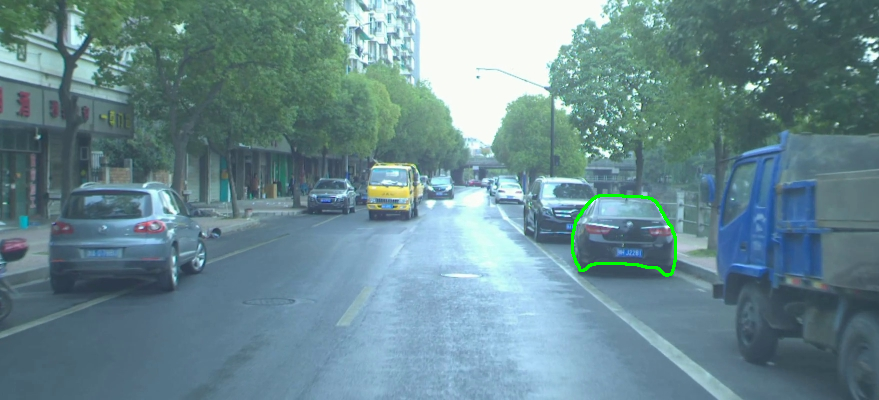

Instance 1


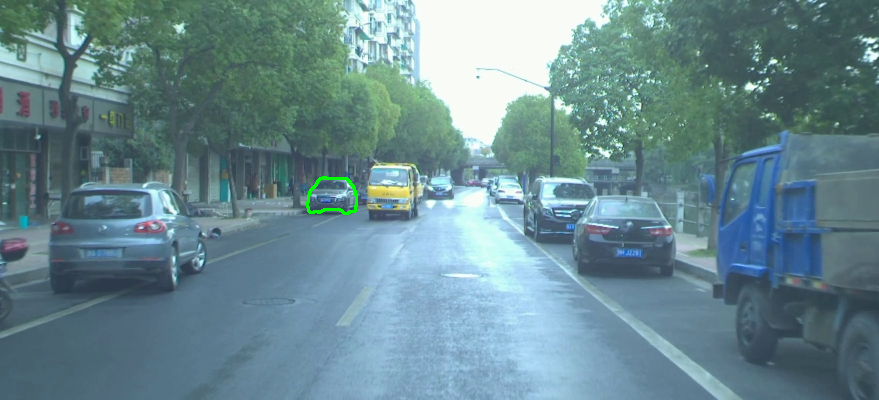

Instance 2


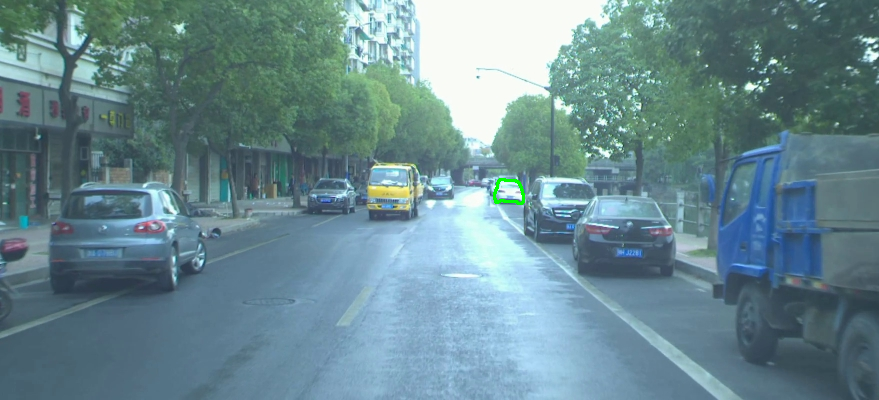

Instance 3


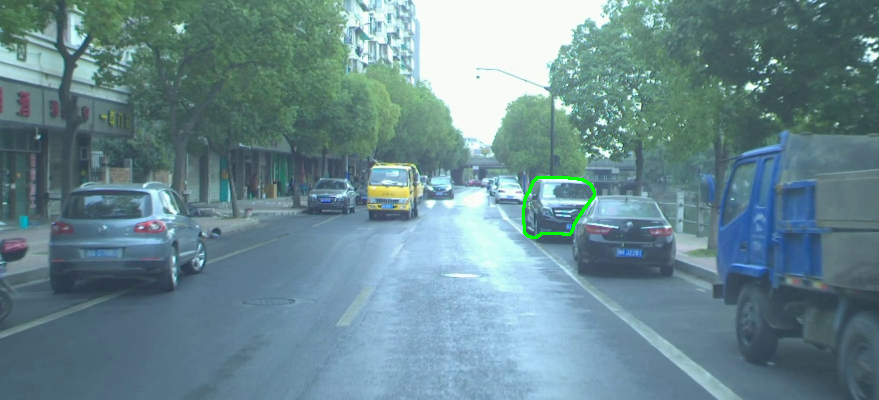

Instance 4


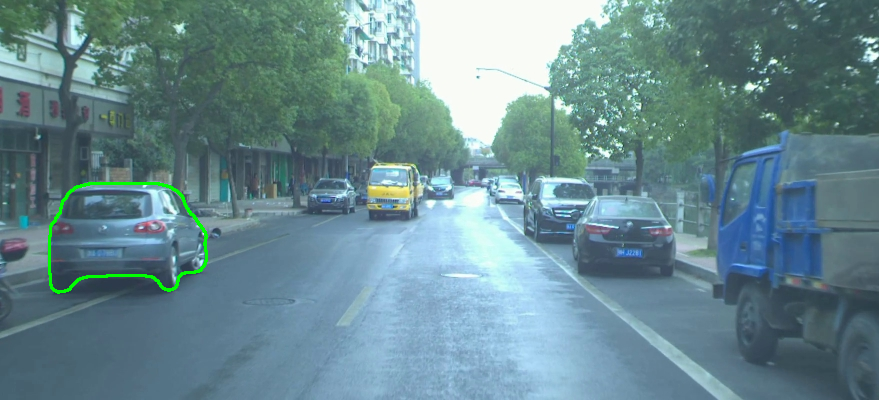

Instance 5


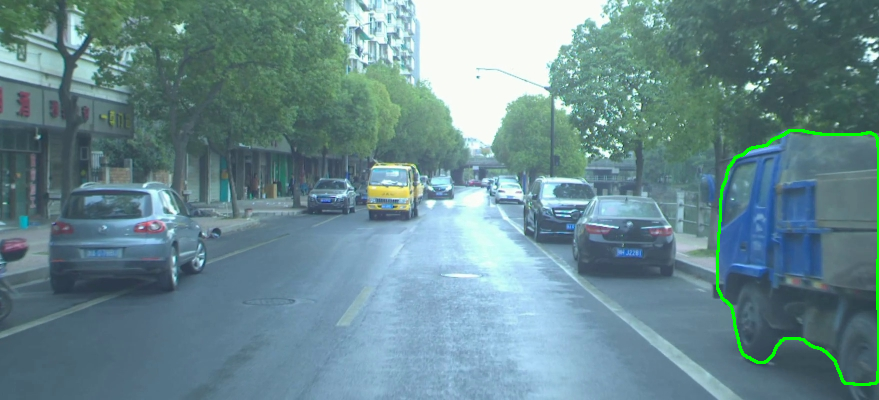

Instance 6


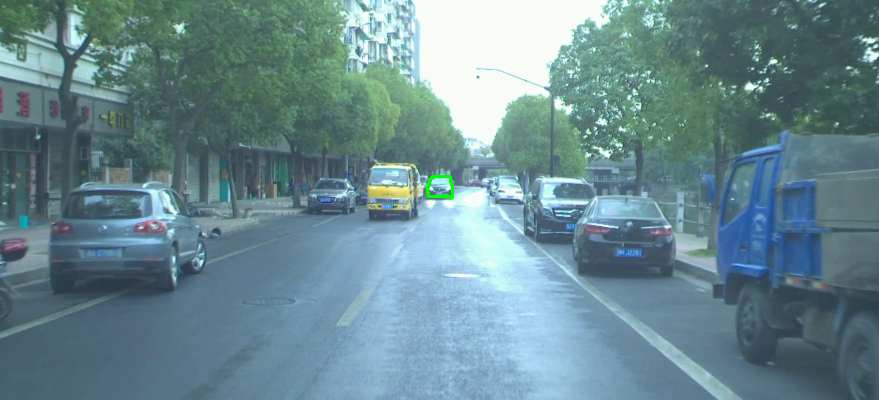

Instance 7


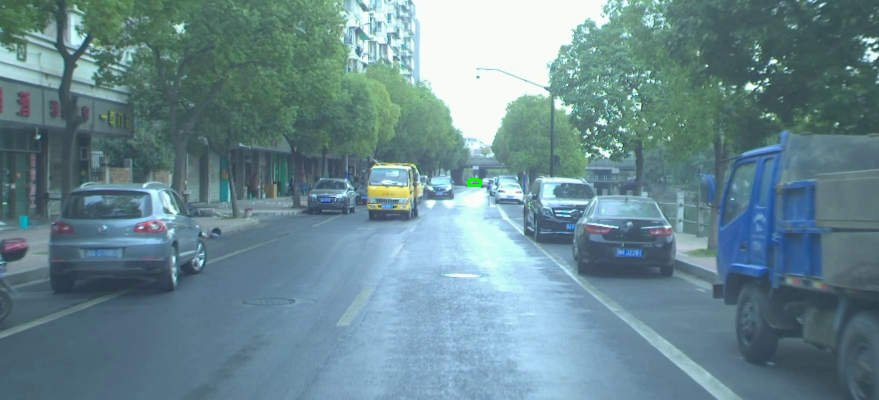

Instance 8


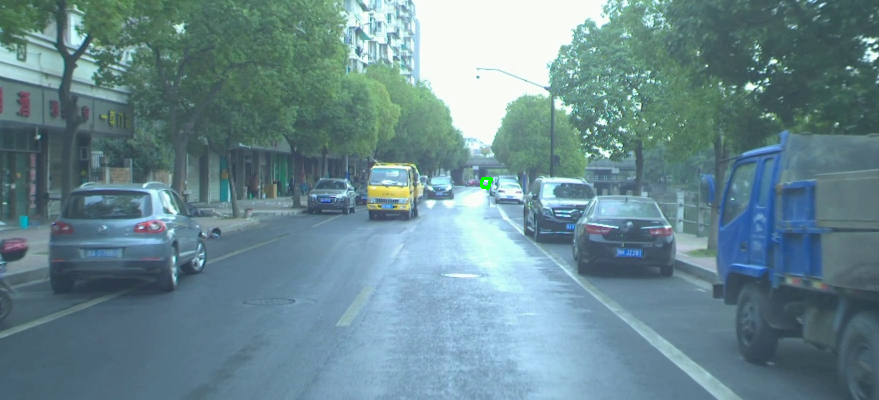

Instance 9


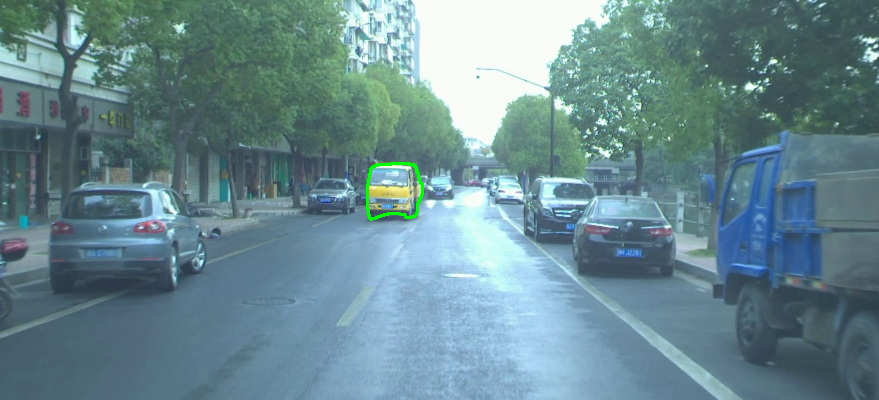

Instance 10


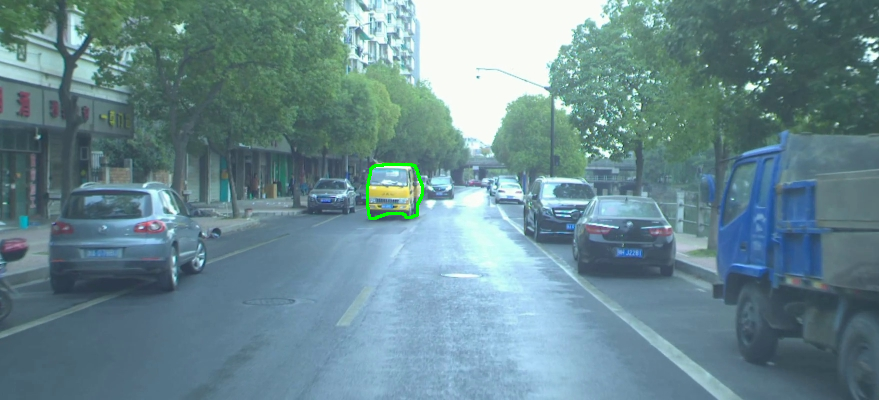

Instance 11


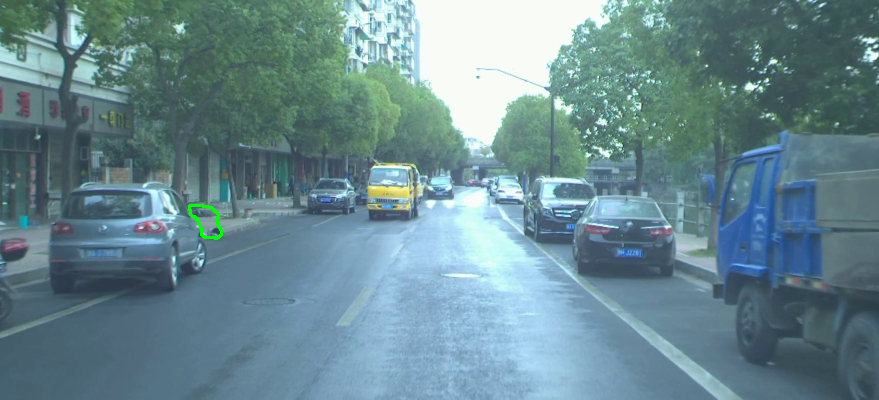

Instance 12


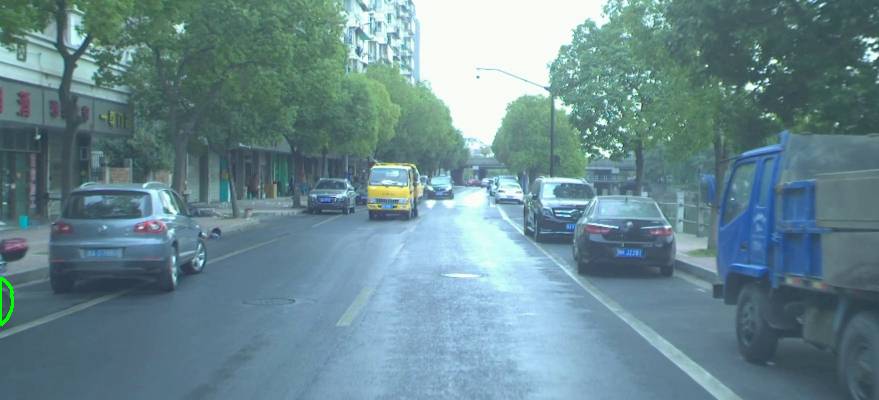

Instance 13


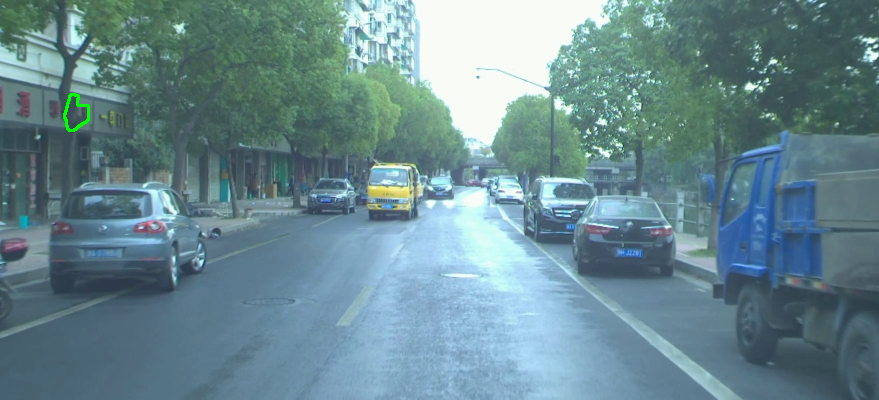

Instance 14


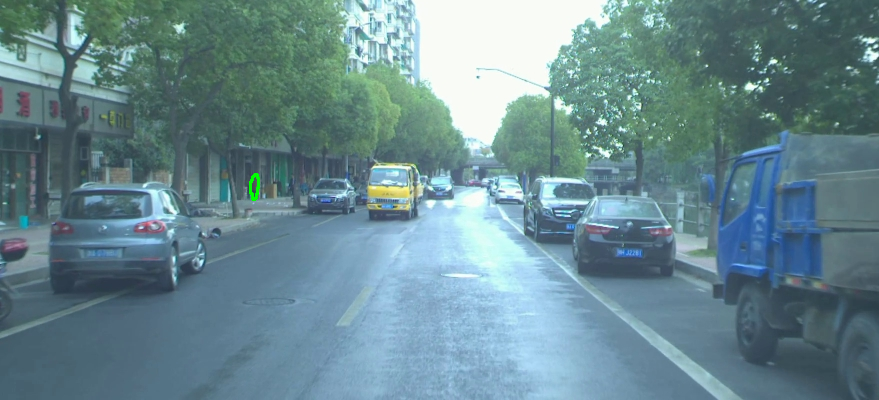

Instance 15


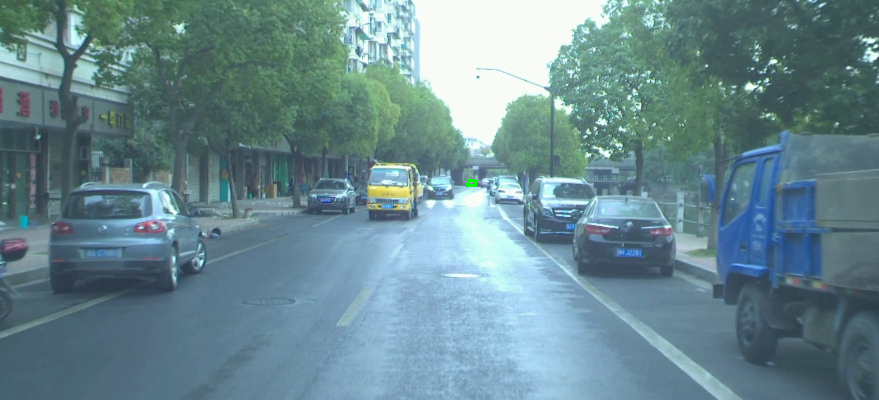

Instance 16


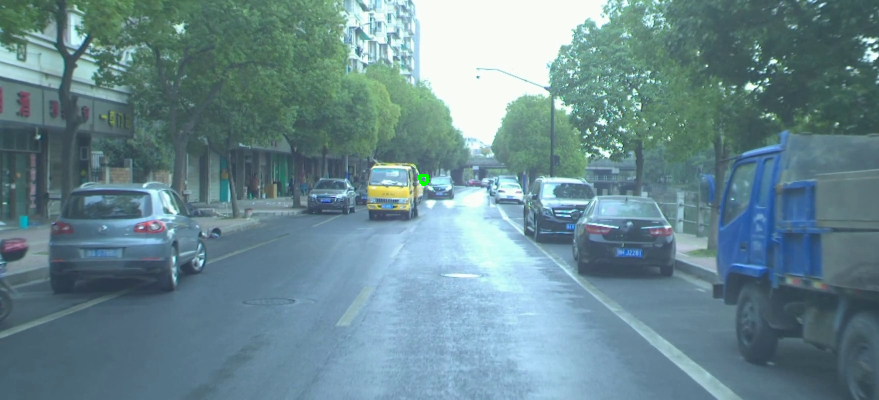

Instance 17


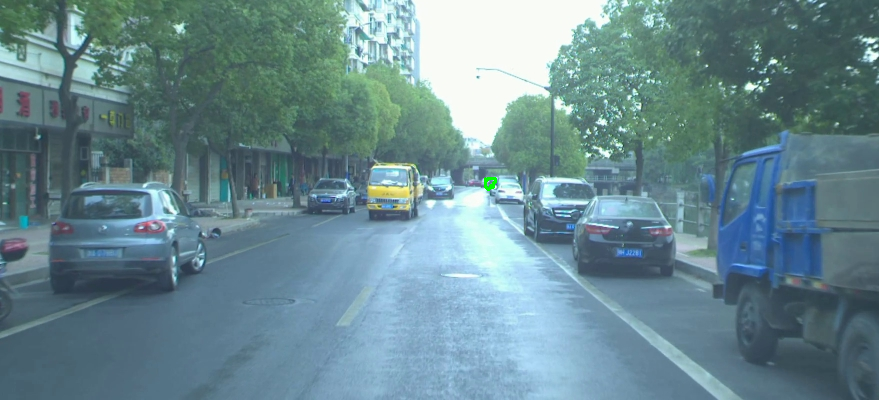

Instance 18


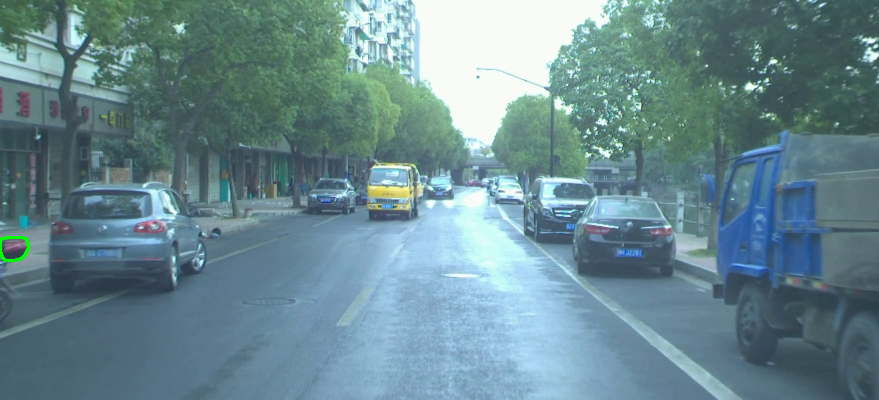

Instance 19


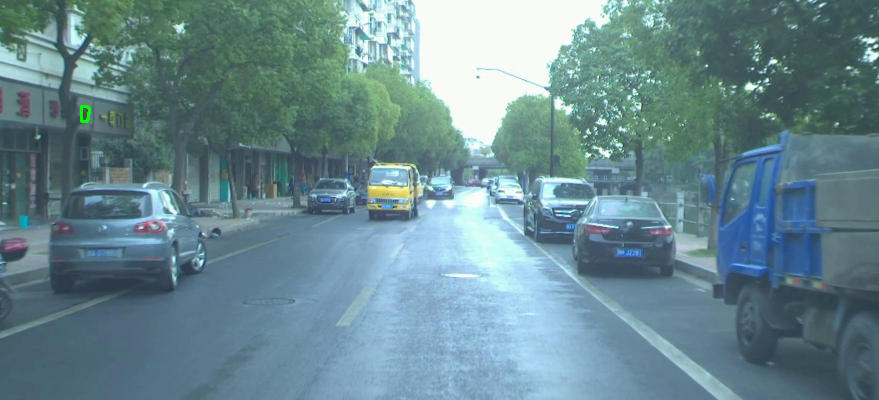

Instance 20


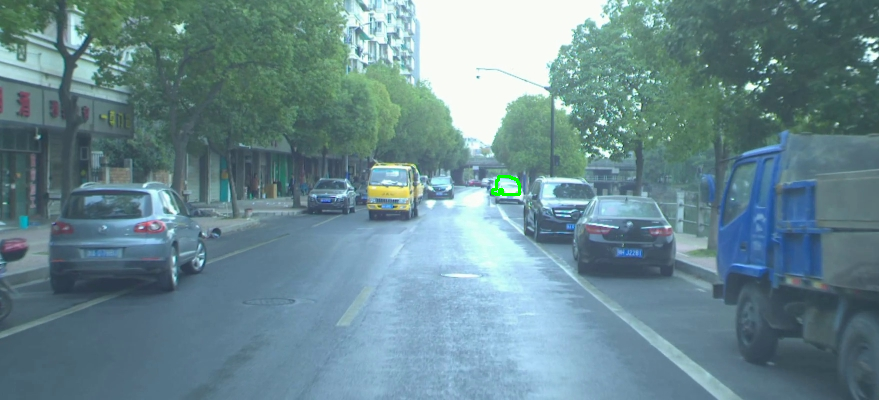

Instance 21


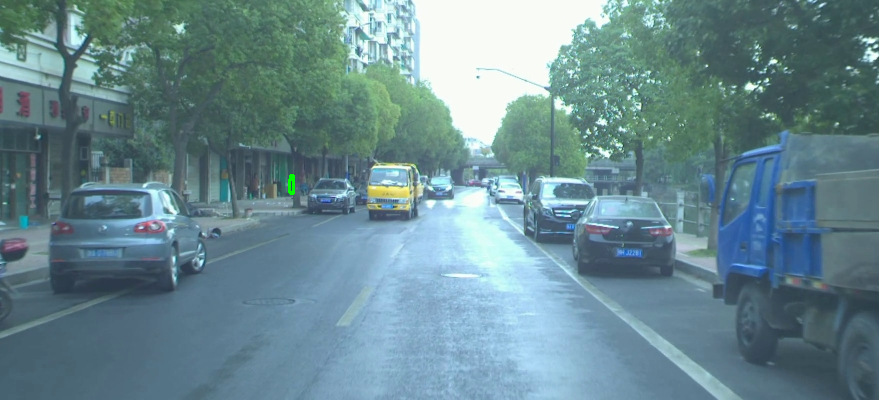

Instance 22


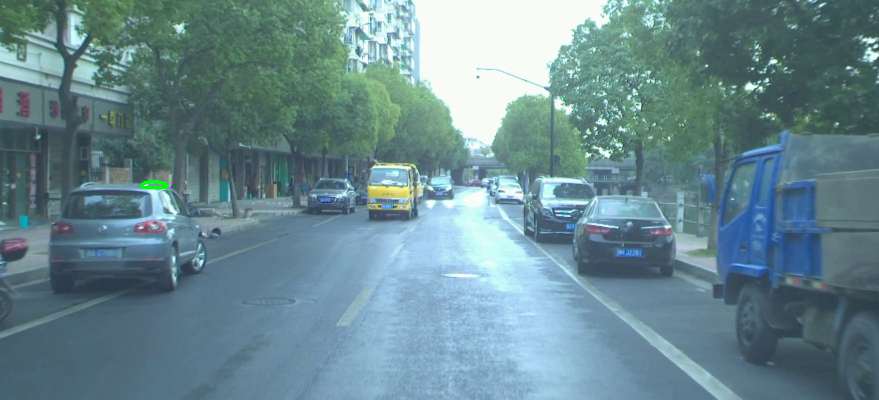

Instance 23


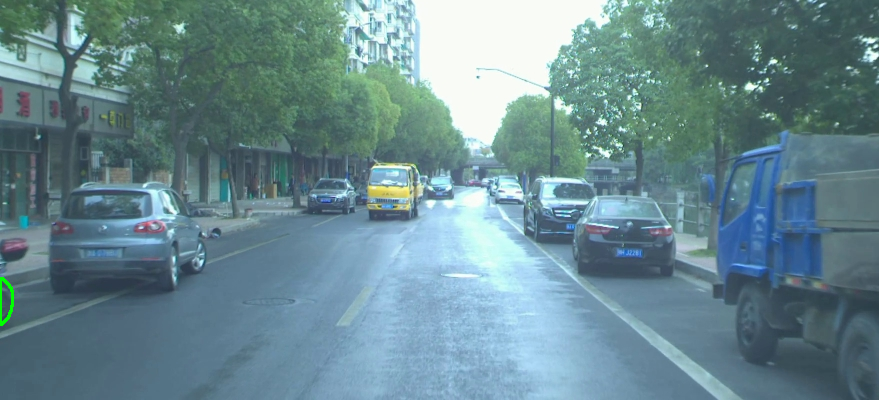

Instance 24


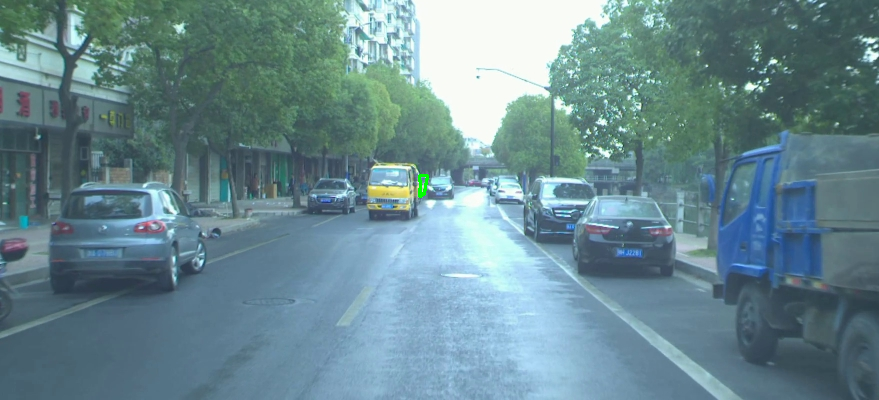

Instance 25


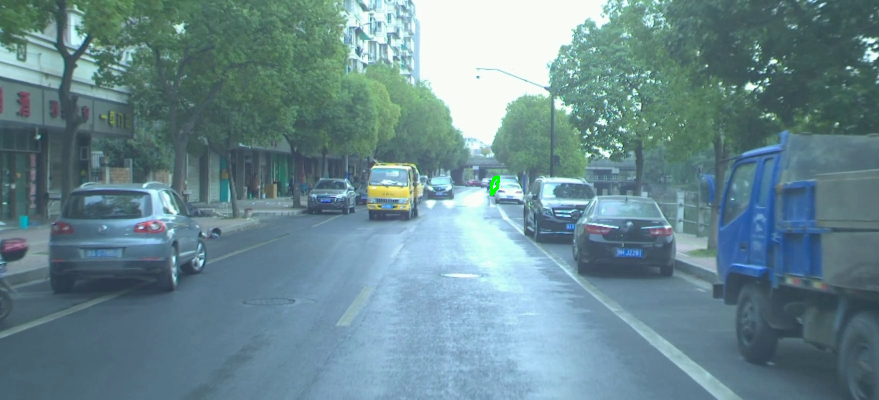

Instance 26


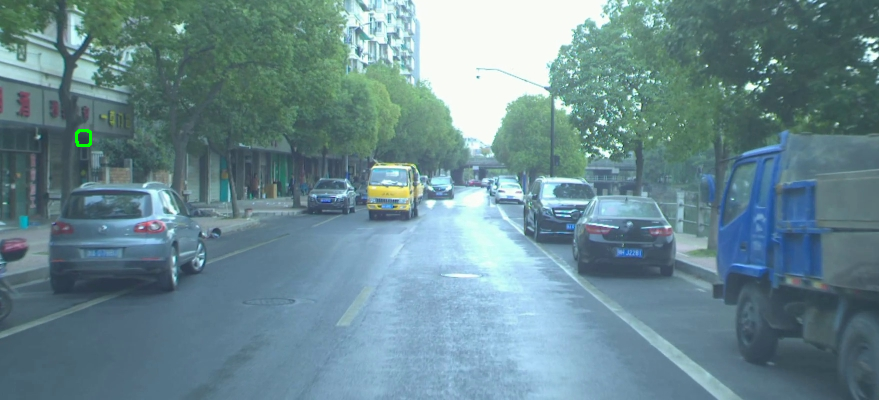

Instance 27


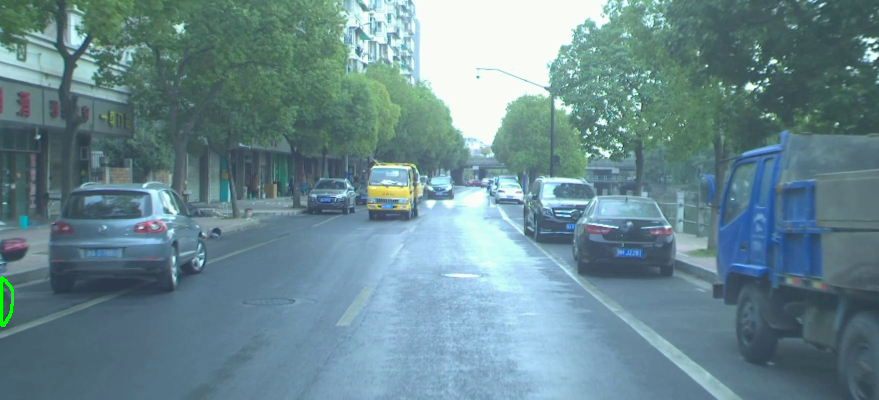

Instance 28


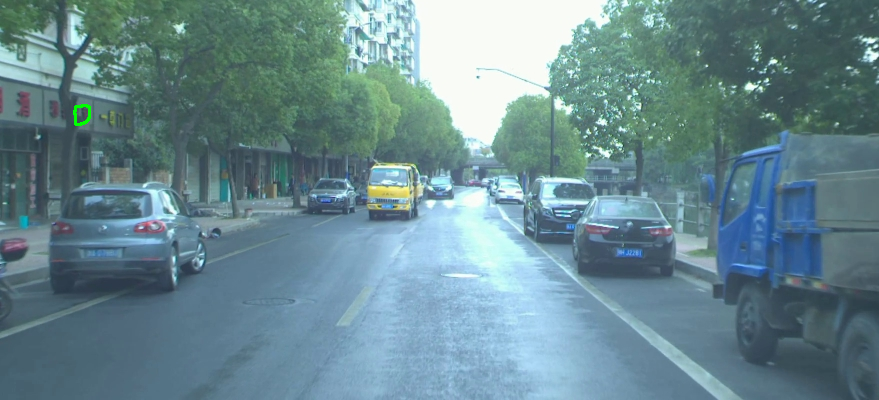

Instance 29


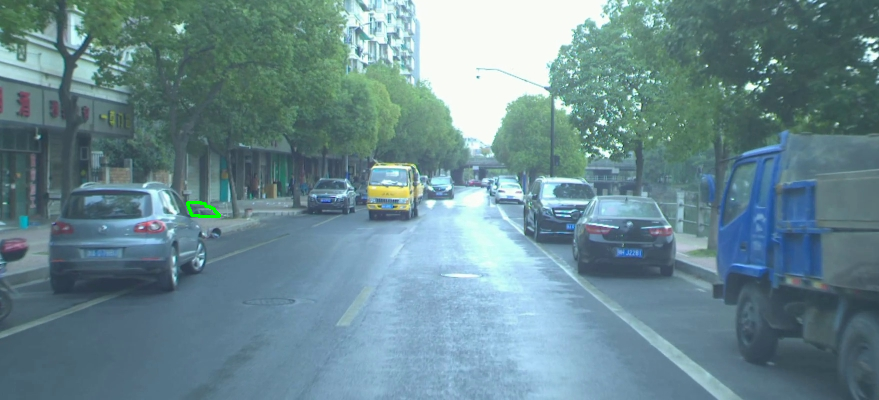

Instance 30


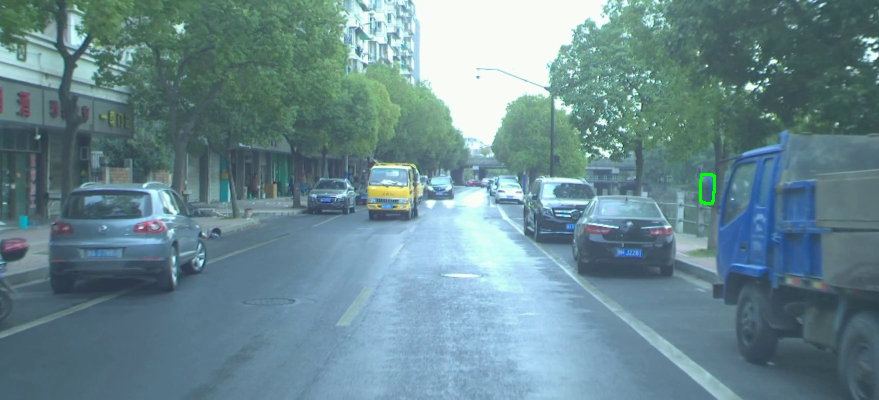

Instance 31


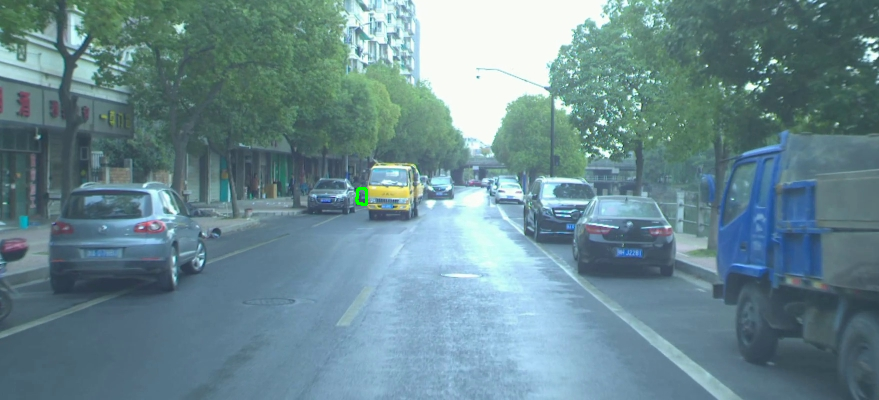

Instance 32


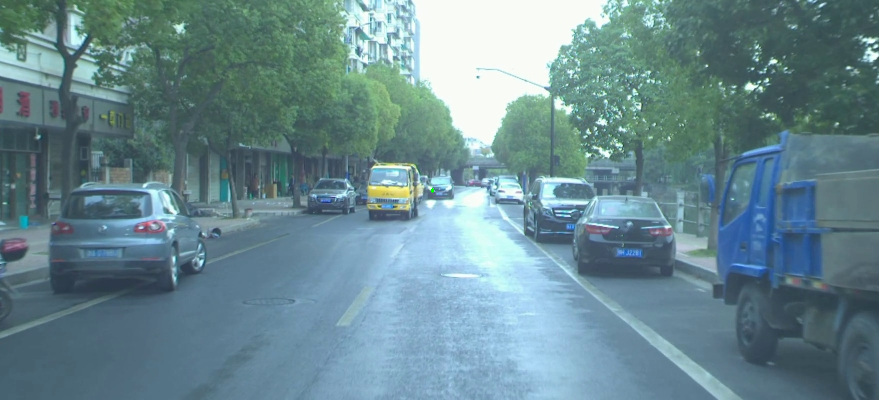

Instance 33


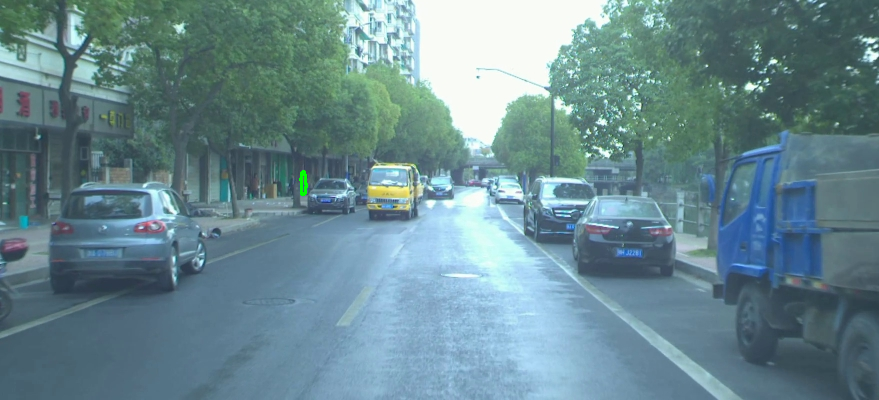

Instance 34


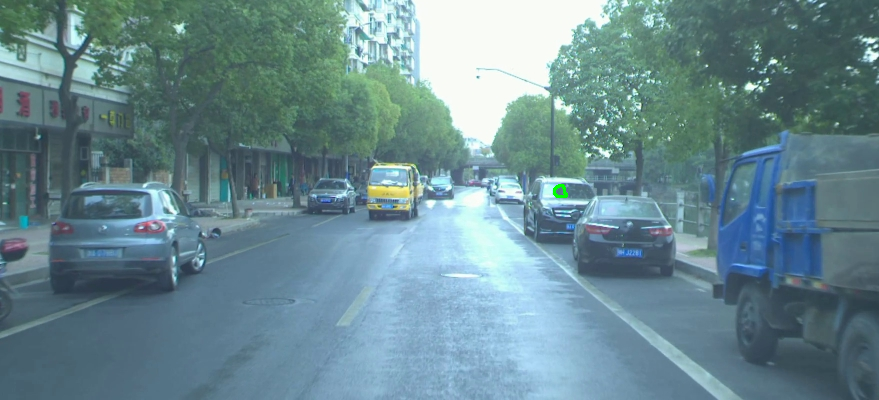

Instance 35


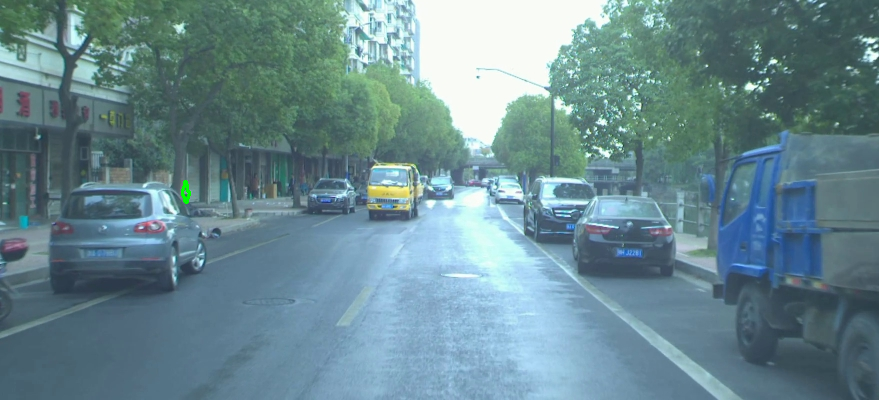

Instance 36


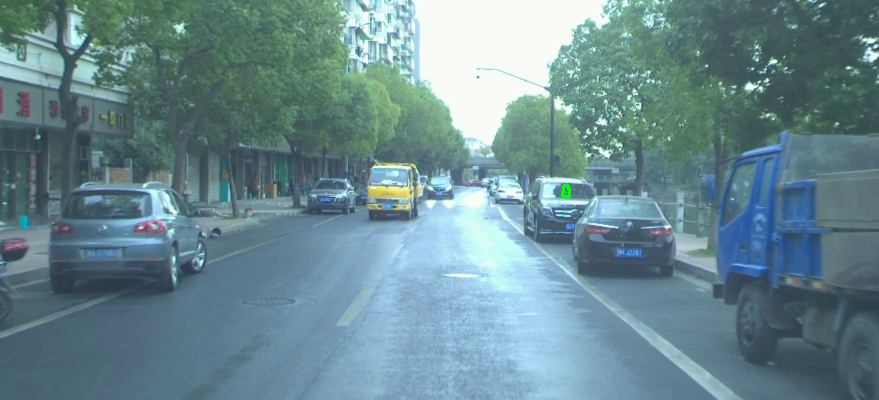

Instance 37


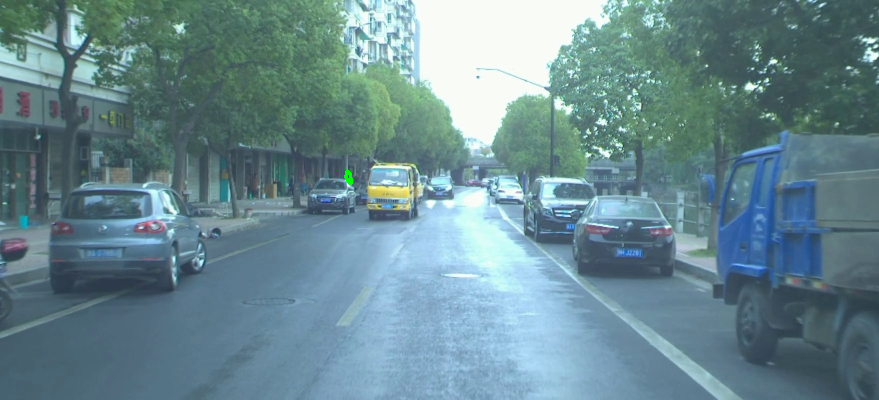

Instance 38


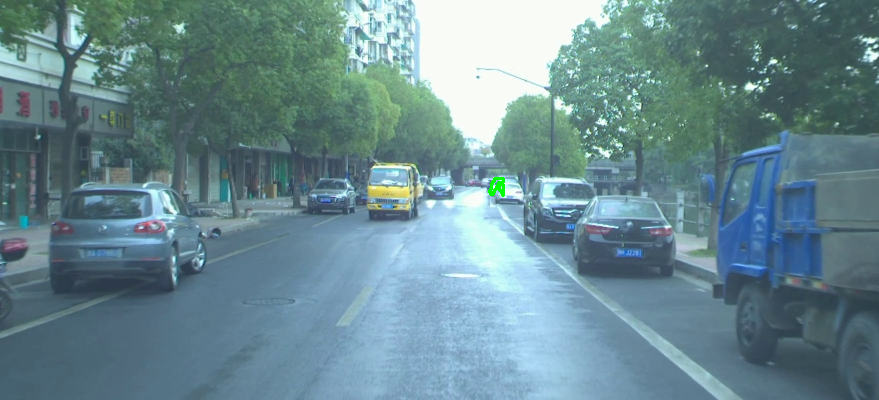

Instance 39


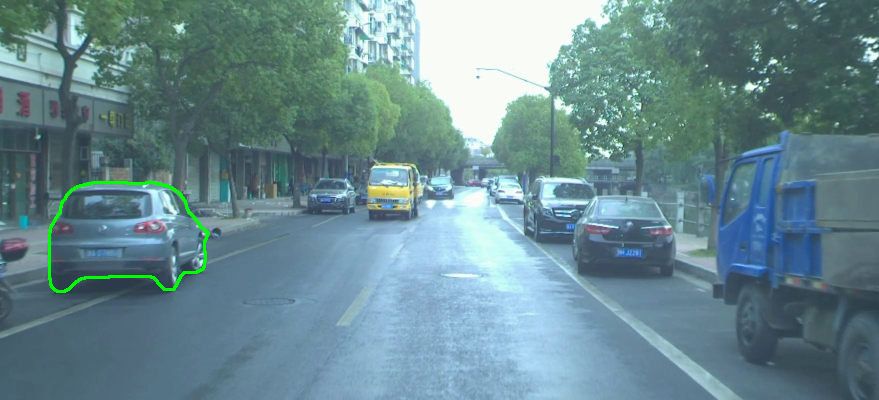

Instance 40


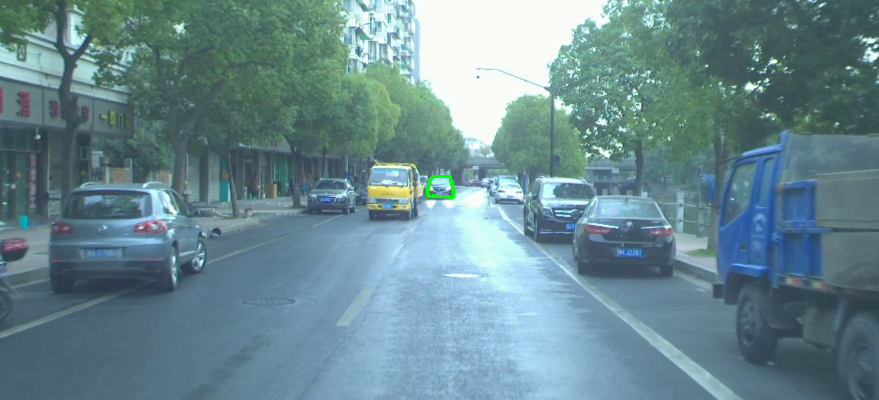

Instance 41


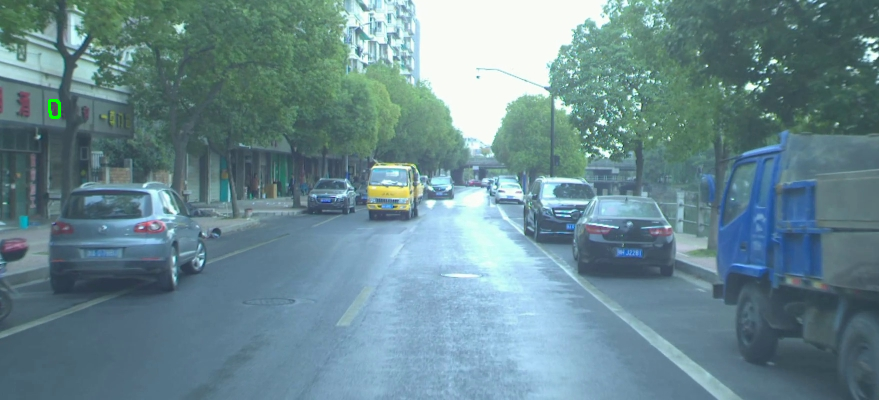

Instance 42


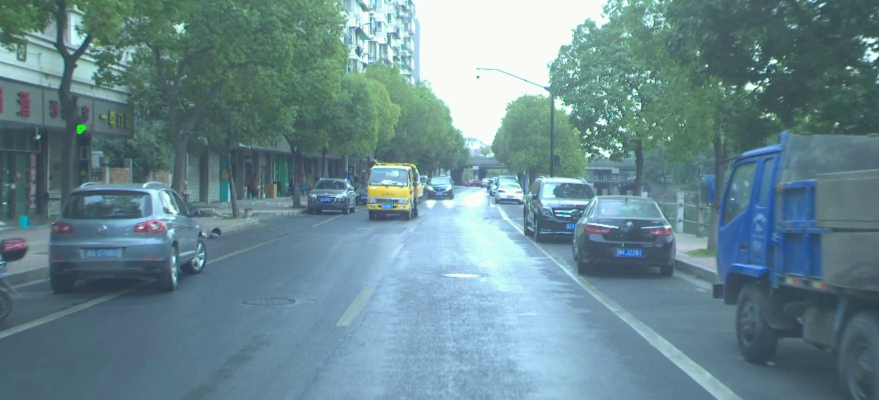

Instance 43


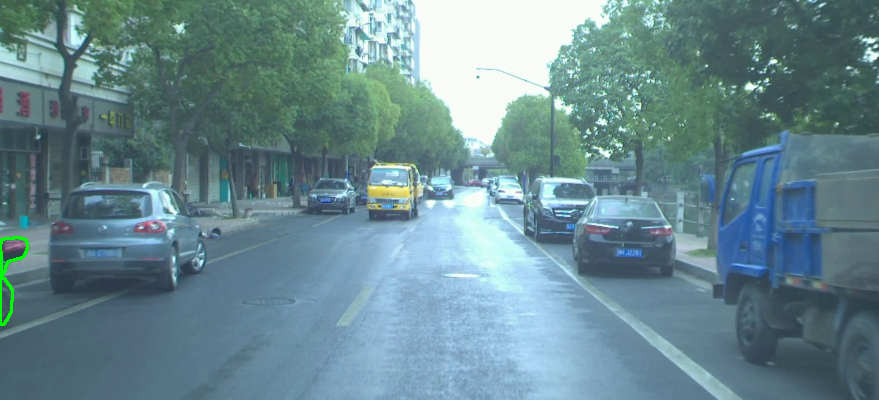

In [28]:
i = 0
contours = get_countours(image, False)
for contour in contours:
    print('Instance', i)
    i = i + 1
    image_with_overlaid_predictions = image.copy()
    cv2_imshow(cv2.drawContours(image_with_overlaid_predictions, [contour], -1, (0,255, 0), 2))

def show_contour_at_i(image, contours, i):
  countour = contours[i]
  image_with_overlaid_predictions = image.copy()
  cv2_imshow(cv2.drawContours(image_with_overlaid_predictions, [contour], -1, (0,255, 0), 2))

yellow truck binary mask


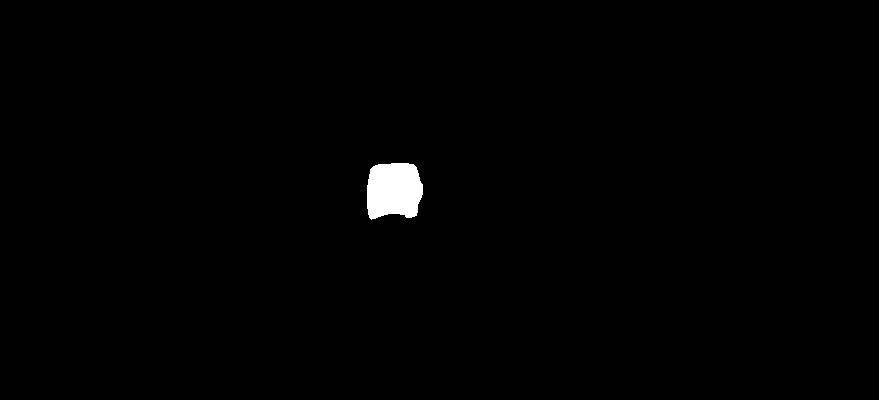

In [31]:
def get_mask_at_i(image, i):
  # Get the binary mask.
  segment = numpy.array(predictor(image)['instances'].pred_masks[i].to("cpu")).astype(numpy.uint8)
  h, w = segment.shape
  mask = numpy.zeros((h, w), dtype=numpy.uint8) + segment

  for i in range(h):
    for j in range(w):
      if mask[i][j] == 1:
        mask[i][j] = 255

  return mask

print('yellow truck binary mask')
cv2_imshow(get_mask_at_i(image, 9))

mask = get_mask_at_i(image, 9)

Extract boundaries (If the mask is A, Boundary extraction : A - (A (-) S), where S is a standard structural element.

boundaries


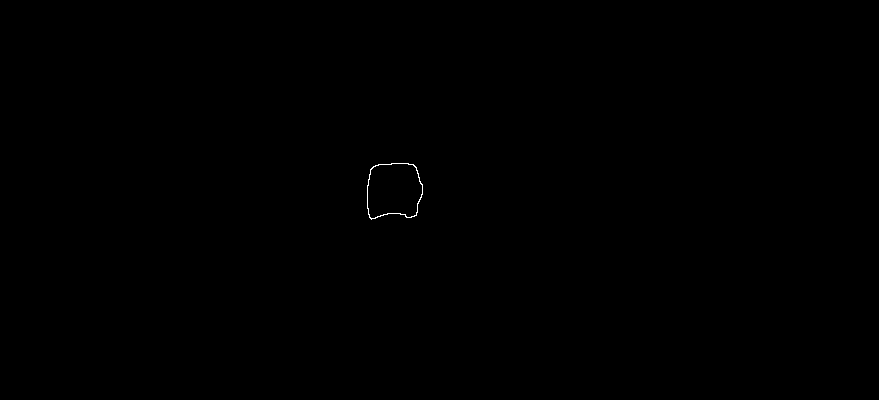

In [32]:
se = numpy.ones((3, 3), dtype=numpy.uint8)
eroded_mask = cv2.erode(mask, se)

boundaries = mask - eroded_mask
print('boundaries')
cv2_imshow(boundaries)

Freeman Chaincode (n-8)

In [33]:
def get_start_point(image):
    start_point = [0, 0]
    for j in range(image.shape[1]):
      for i in range(image.shape[0]):
        if (image[i][j] == 255):
          start_point[0] = i
          start_point[1] = j
          return start_point

print('Starting point:', get_start_point(mask))
start_point = get_start_point(mask)

Starting point: [185, 367]


In [37]:
def is_in_range(image, point):
    if point[0] >= 0 and point[0] < image.shape[0] and point[1] >= 0 and point[1] < image.shape[1]:
      return True
    return False

def chain_code_8n(image, start_point):
  s = ""
  visited = list()

  prev_point = [-1, -1]
  curr_point = start_point
  
  while curr_point in visited and prev_point[0] != curr_point[0] or prev_point[1] != curr_point[1]:
    prev_point = curr_point

    if (is_in_range(image, [prev_point[0]+1, prev_point[1]]) and image[curr_point[0]+1][curr_point[1]] == 255 and not [prev_point[0]+1, prev_point[1]] in visited):
      curr_point = [curr_point[0]+1, curr_point[1]]
      s += '0'
      
    elif (is_in_range(image,  [prev_point[0]+1, prev_point[1]+1]) and image[curr_point[0]+1][curr_point[1]+1] == 255 and not [prev_point[0]+1, prev_point[1]+1] in visited):
      curr_point = [curr_point[0]+1, curr_point[1]+1]
      s += '7'

    elif (is_in_range(image,  [prev_point[0], prev_point[1]+1]) and image[curr_point[0]][curr_point[1]+1] == 255 and not [prev_point[0], prev_point[1]+1] in visited):
      curr_point = [curr_point[0], curr_point[1]+1]
      s += '6'

    elif (is_in_range(image,  [prev_point[0]-1, prev_point[1]+1]) and image[curr_point[0]-1][curr_point[1]+1] == 255 and not [prev_point[0]-1, prev_point[1]+1] in visited):
      curr_point = [curr_point[0]-1, curr_point[1]+1]
      s += '5'

    elif (is_in_range(image,  [prev_point[0]-1, prev_point[1]]) and image[curr_point[0]-1][curr_point[1]] == 255 and not [prev_point[0]-1, prev_point[1]] in visited):
      curr_point = [curr_point[0]-1, curr_point[1]]
      s += '4'
      
    elif (is_in_range(image,  [prev_point[0]-1, prev_point[1]-1]) and image[curr_point[0]-1][curr_point[1]-1] == 255 and not [prev_point[0]-1, prev_point[1]-1] in visited):
      curr_point = [curr_point[0]-1, curr_point[1]-1]
      s += '3'

    elif (is_in_range(image,  [prev_point[0], prev_point[1]-1]) and image[curr_point[0]][curr_point[1]-1] == 255 and not [prev_point[0], prev_point[1]-1] in visited):
      curr_point = [curr_point[0], curr_point[1]-1]
      s += '2'

    elif (is_in_range(image,  [prev_point[0]+1, prev_point[1]-1]) and image[curr_point[0]+1][curr_point[1]-1] == 255 and not [prev_point[0]+1, prev_point[1]-1] in visited):
      curr_point = [curr_point[0]+1, curr_point[1]-1]
      s += '1'

    visited.append(curr_point)

  return s

print('chain code of mask : ', chain_code_8n(boundaries, get_start_point(boundaries)))
print('boundary length : ', len(chain_code_8n(boundaries, get_start_point(boundaries))))

chain code of mask :  0000000000000000000000070000070077566656566566566656666666666676666707666665665644544444444545454544544444444443034430
boundary length :  118


image_1_2018-10-31-06-55-01_2018-10-31-07-00-50-232.jpg


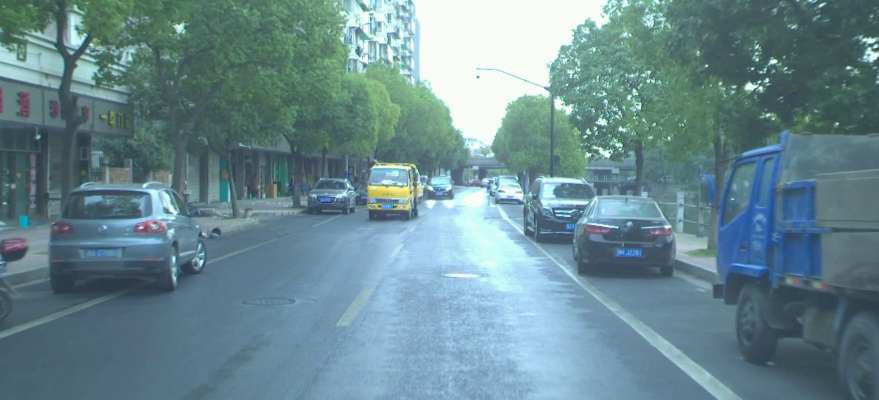

panoptic segmentations


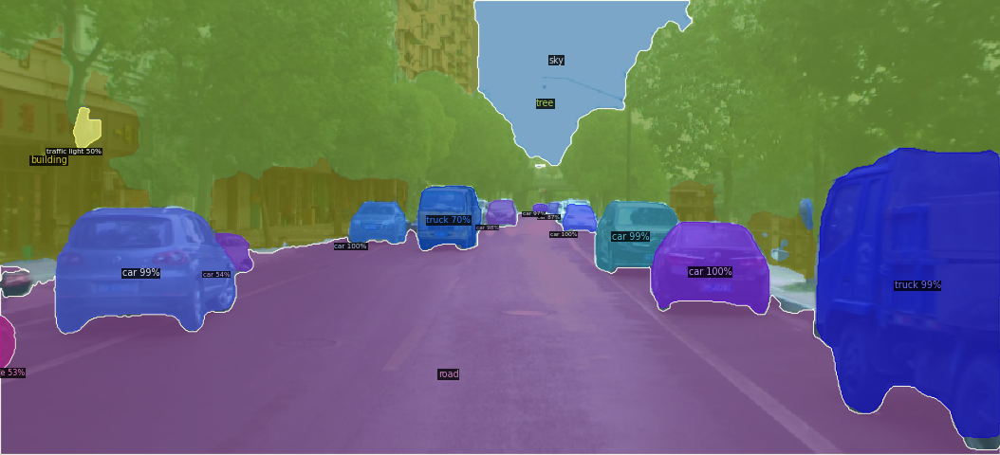

instance predictions


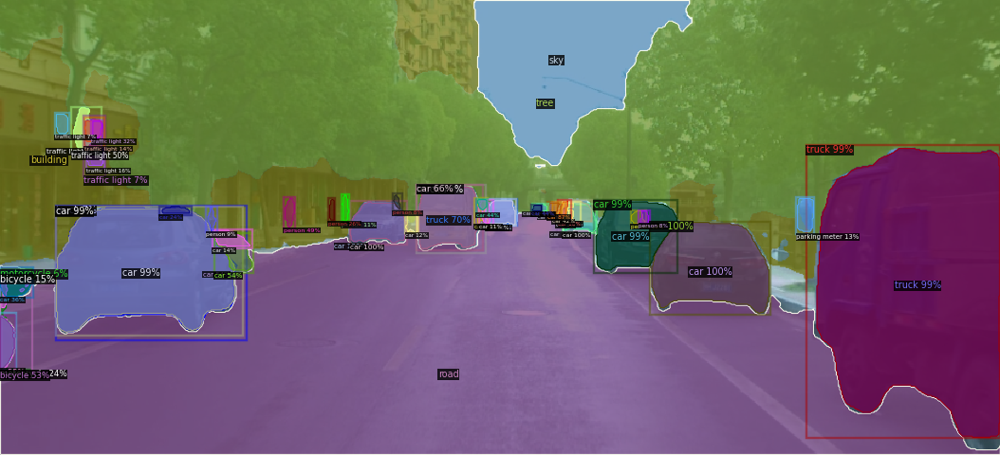

contour :  0
mask


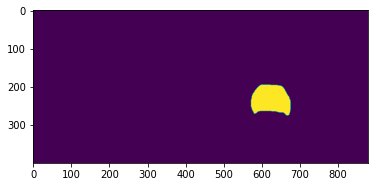

contour :  1
mask


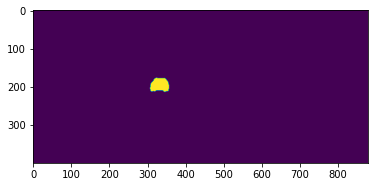

contour :  2
mask


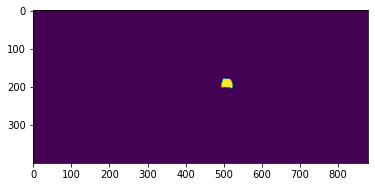

contour :  3
mask


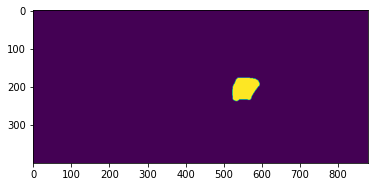

contour :  4
mask


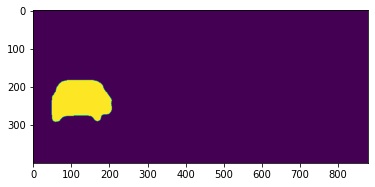

contour :  5
mask


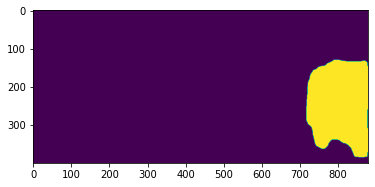

contour :  6
mask


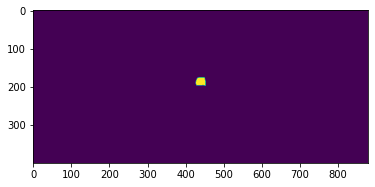

contour :  7
mask


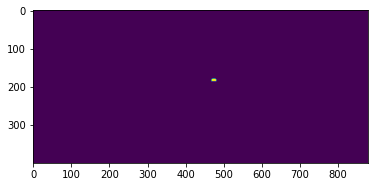

contour :  8
mask


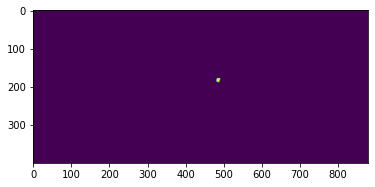

contour :  9
mask


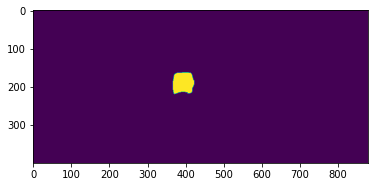

contour :  10
mask


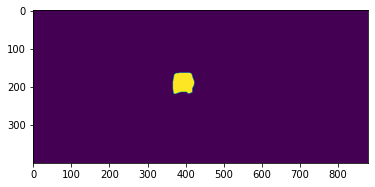

contour :  11
mask


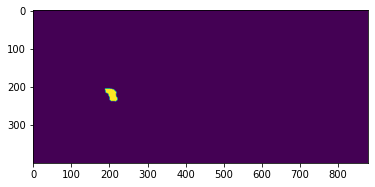

contour :  12
mask


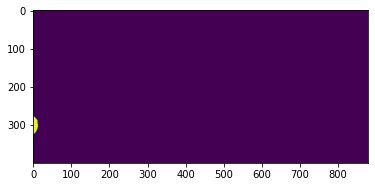

contour :  13
mask


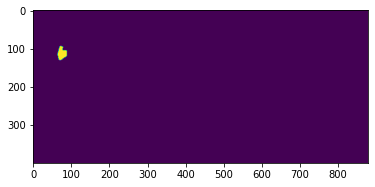

contour :  14
mask


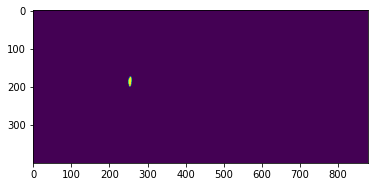

contour :  15
mask


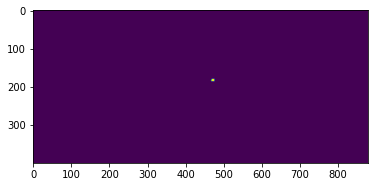

contour :  16
mask


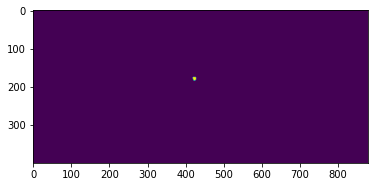

contour :  17
mask


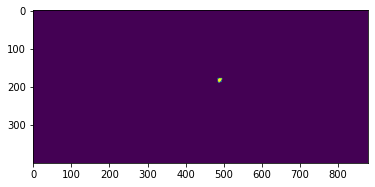

contour :  18
mask


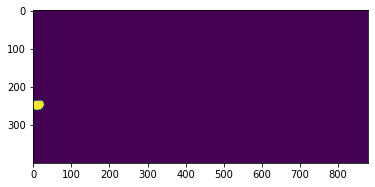

contour :  19
mask


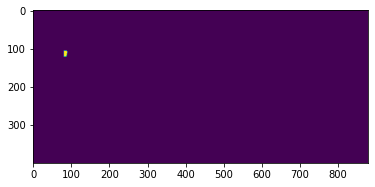

contour :  20
mask


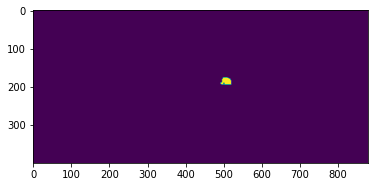

contour :  21
mask


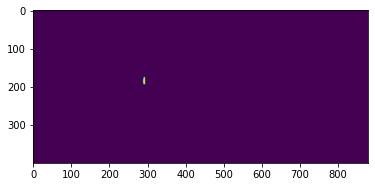

contour :  22
mask


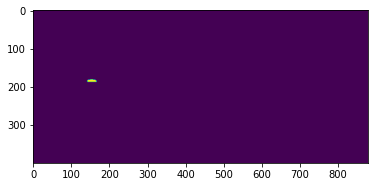

contour :  23
mask


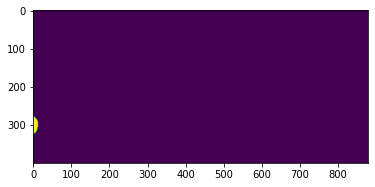

contour :  24
mask


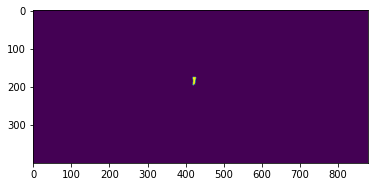

contour :  25
mask


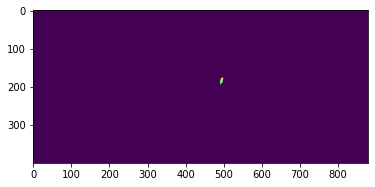

contour :  26
mask


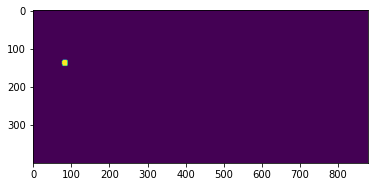

contour :  27
mask


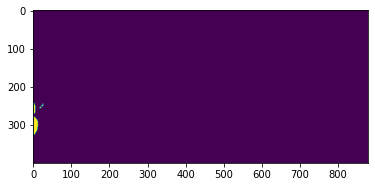

contour :  28
mask


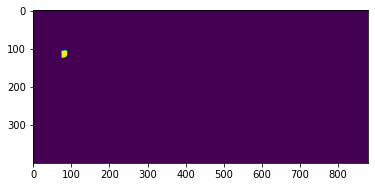

contour :  29
mask


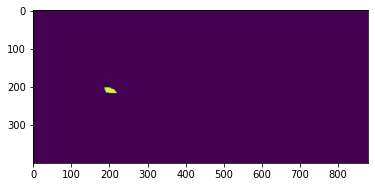

contour :  30
mask


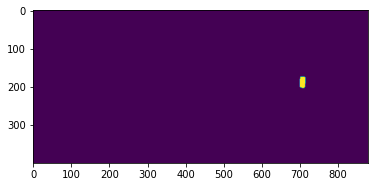

contour :  31
mask


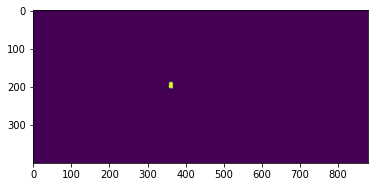

contour :  32
mask


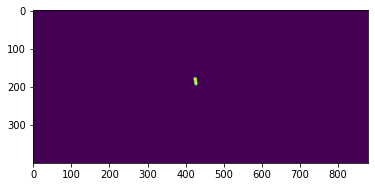

contour :  33
mask


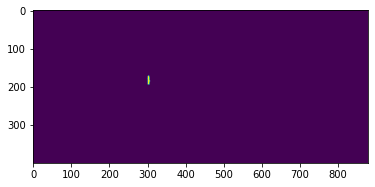

contour :  34
mask


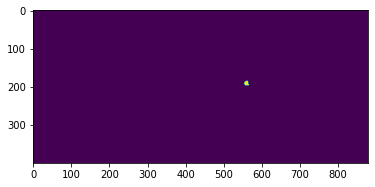

contour :  35
mask


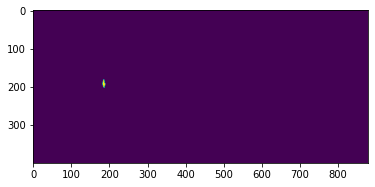

contour :  36
mask


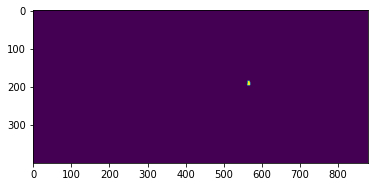

contour :  37
mask


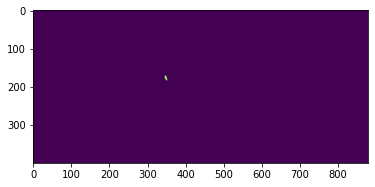

contour :  38
mask


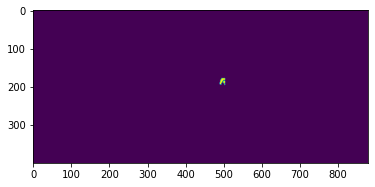

contour :  39
mask


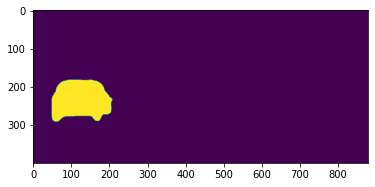

contour :  40
mask


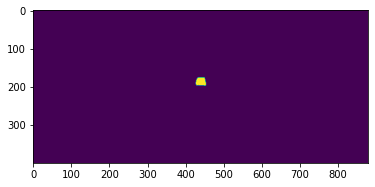

contour :  41
mask


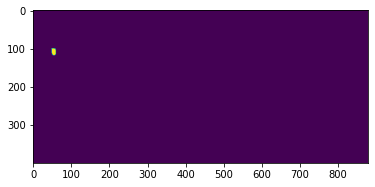

contour :  42
mask


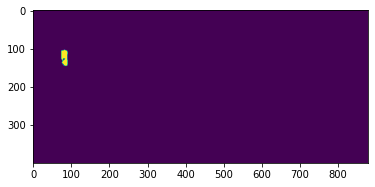

contour :  43
mask


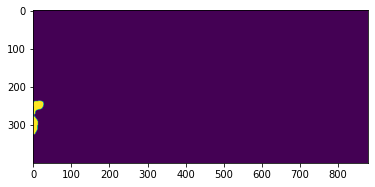

Enter countour ID9
contour :  0
contour :  1
contour :  2
contour :  3
contour :  4
contour :  5
contour :  6
contour :  7
contour :  8
contour :  9
contour :  10
contour :  11
contour :  12
contour :  13
contour :  14
contour :  15
contour :  16
contour :  17
contour :  18
contour :  19
contour :  20
contour :  21
contour :  22
contour :  23
contour :  24
contour :  25
contour :  26
contour :  27
contour :  28
contour :  29
contour :  30
contour :  31
contour :  32
contour :  33
contour :  34
contour :  35
contour :  36
contour :  37
contour :  38
contour :  39
contour :  40
contour :  41
contour :  42
contour :  43


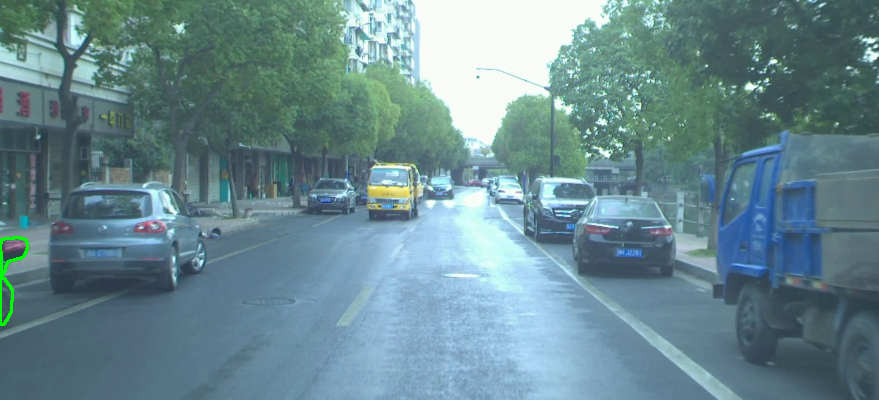

image_1_2018-10-31-06-55-01_2018-10-31-07-00-50-232.jpg
boundaries


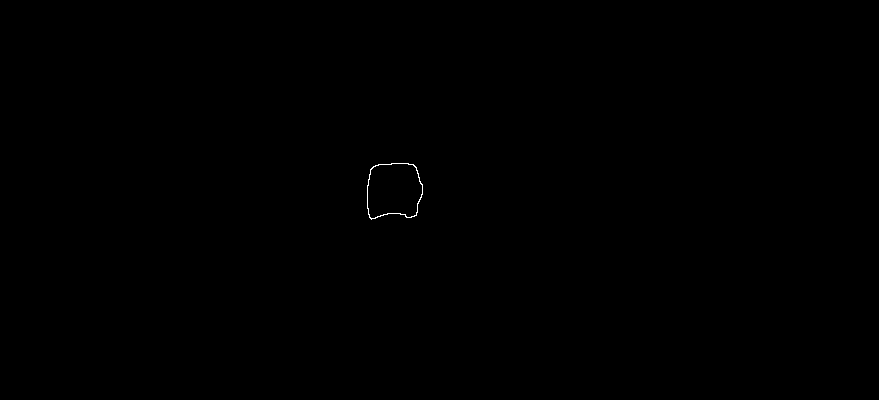

chain code of mask :  0000000000000000000000070000070077566656566566566656666666666676666707666665665644544444444545454544544444444443034430
boundary length :  118
image_2_2018-10-31-06-55-01_2018-10-31-07-00-50-730.jpg


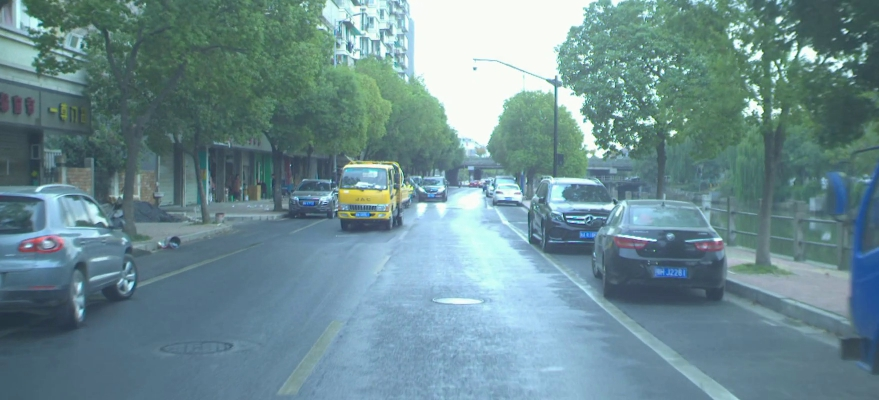

panoptic segmentations


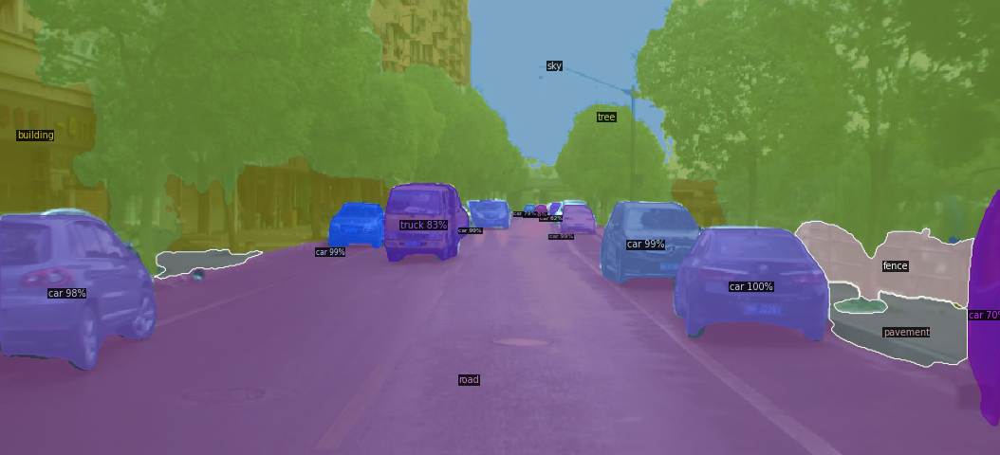

instance predictions


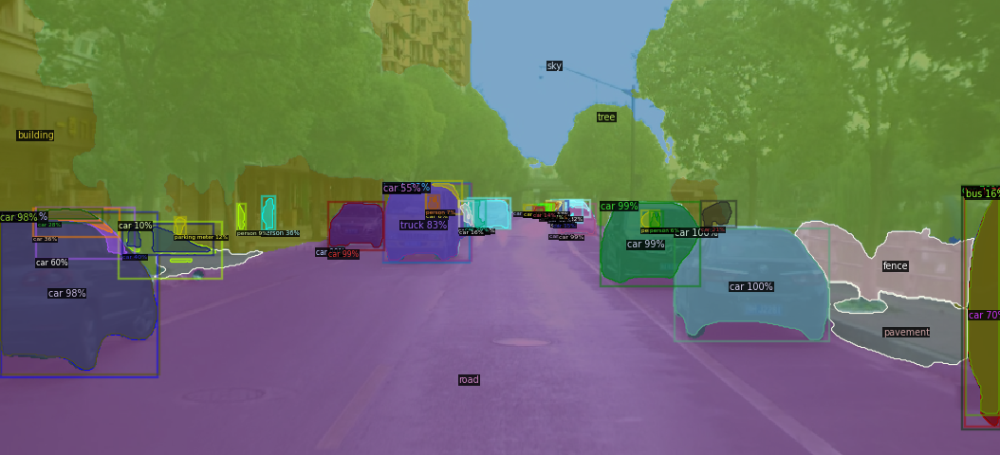

contour :  0
mask


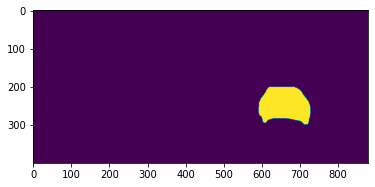

contour :  1
mask


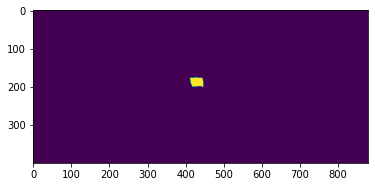

contour :  2
mask


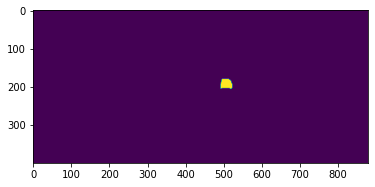

contour :  3
mask


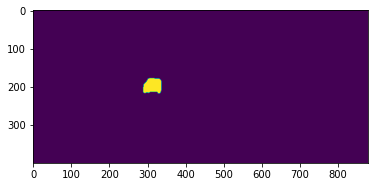

contour :  4
mask


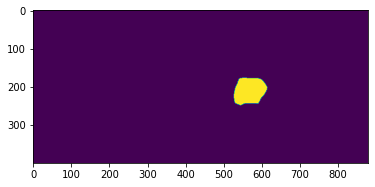

contour :  5
mask


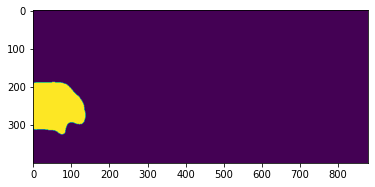

contour :  6
mask


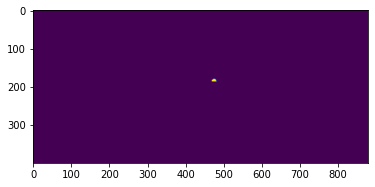

contour :  7
mask


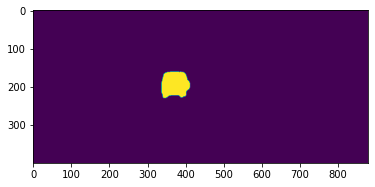

contour :  8
mask


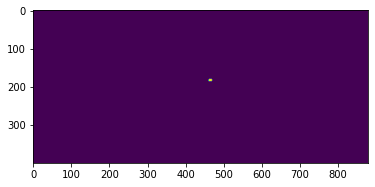

contour :  9
mask


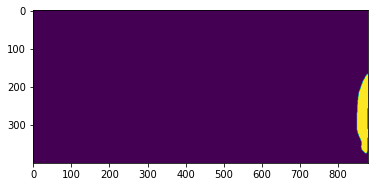

contour :  10
mask


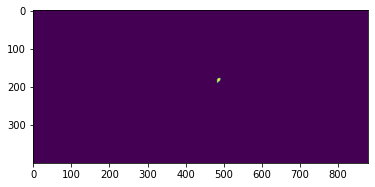

contour :  11
mask


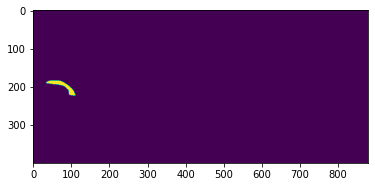

contour :  12
mask


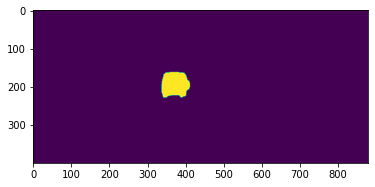

contour :  13
mask


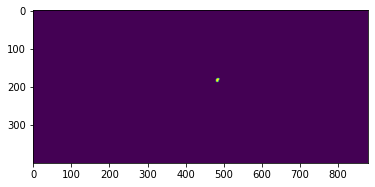

contour :  14
mask


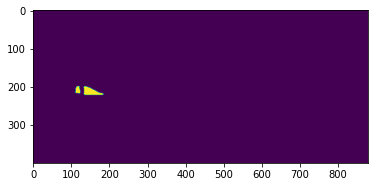

contour :  15
mask


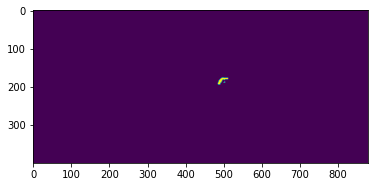

contour :  16
mask


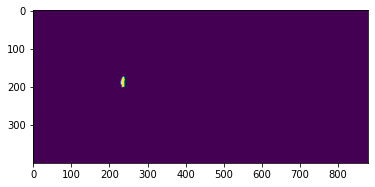

contour :  17
mask


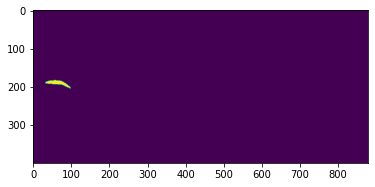

contour :  18
mask


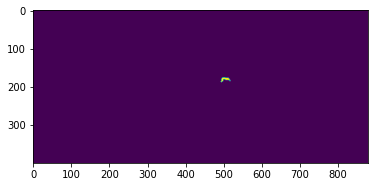

contour :  19
mask


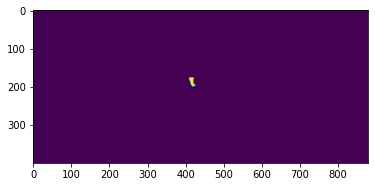

contour :  20
mask


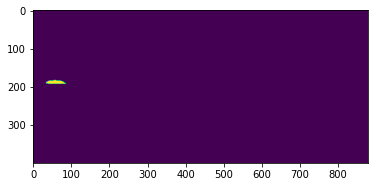

contour :  21
mask


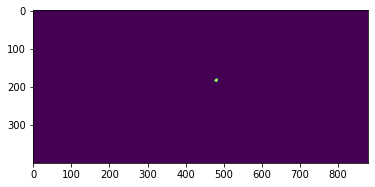

contour :  22
mask


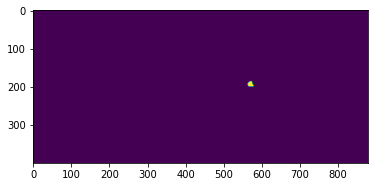

contour :  23
mask


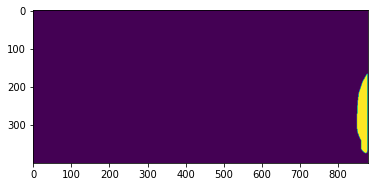

contour :  24
mask


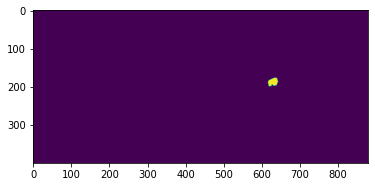

contour :  25
mask


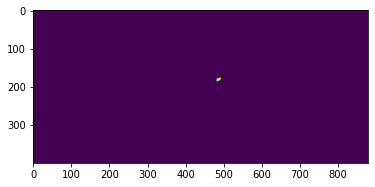

contour :  26
mask


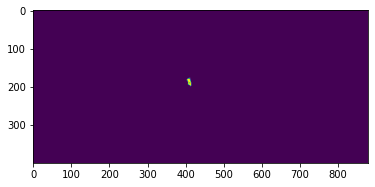

contour :  27
mask


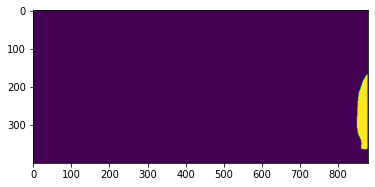

contour :  28
mask


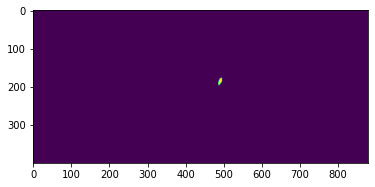

contour :  29
mask


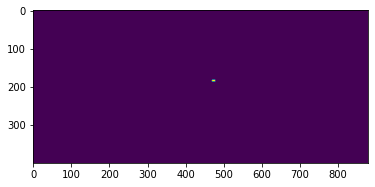

contour :  30
mask


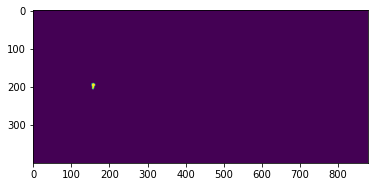

contour :  31
mask


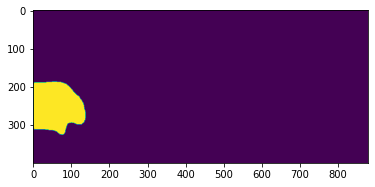

contour :  32
mask


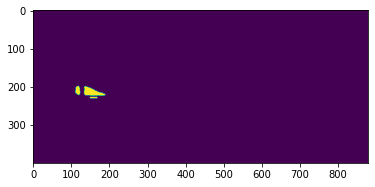

contour :  33
mask


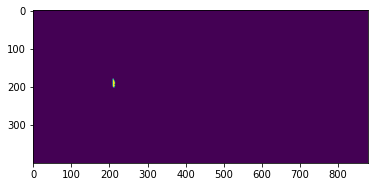

contour :  34
mask


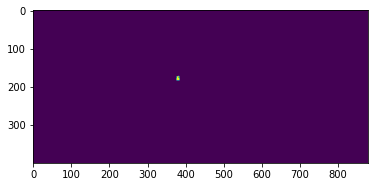

contour :  35
mask


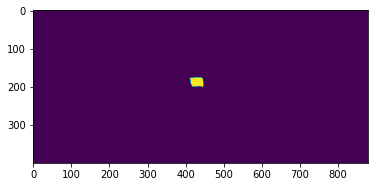

contour :  36
mask


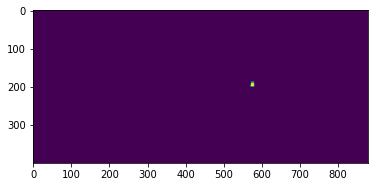

contour :  37
mask


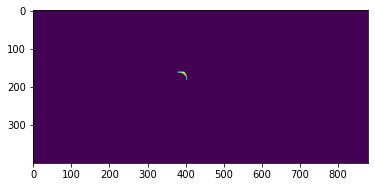

Enter countour ID7
contour :  0
contour :  1
contour :  2
contour :  3
contour :  4
contour :  5
contour :  6
contour :  7
contour :  8
contour :  9
contour :  10
contour :  11
contour :  12
contour :  13
contour :  14
contour :  15
contour :  16
contour :  17
contour :  18
contour :  19
contour :  20
contour :  21
contour :  22
contour :  23
contour :  24
contour :  25
contour :  26
contour :  27
contour :  28
contour :  29
contour :  30
contour :  31
contour :  32
contour :  33
contour :  34
contour :  35
contour :  36
contour :  37


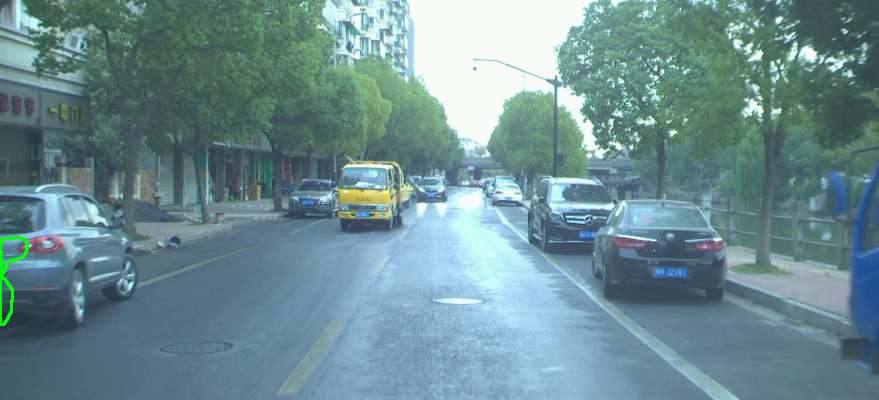

image_2_2018-10-31-06-55-01_2018-10-31-07-00-50-730.jpg
boundaries


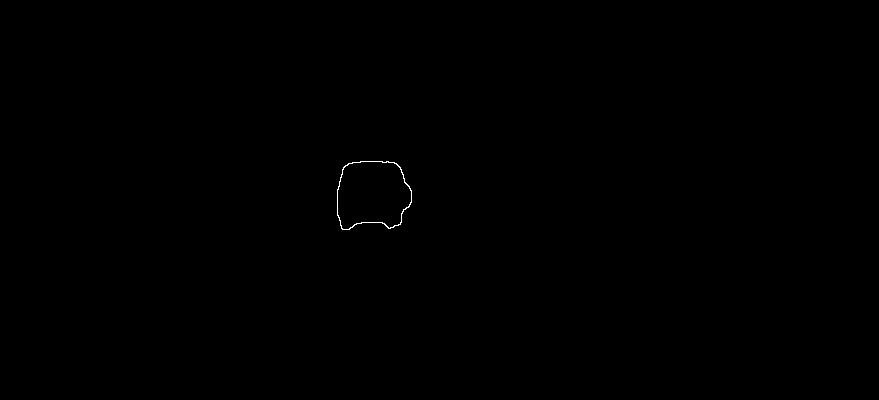

chain code of mask :  0000000000000000000000000070700700007007666666655655565666656666666666666666666767777766566556665645444444445454565565454544444444444430
boundary length :  136
image_3_2018-10-31-06-55-01_2018-10-31-07-00-51-229.jpg


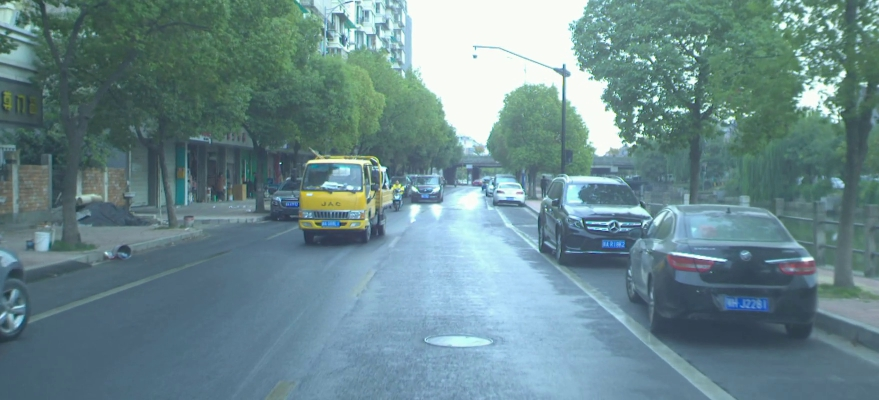

panoptic segmentations


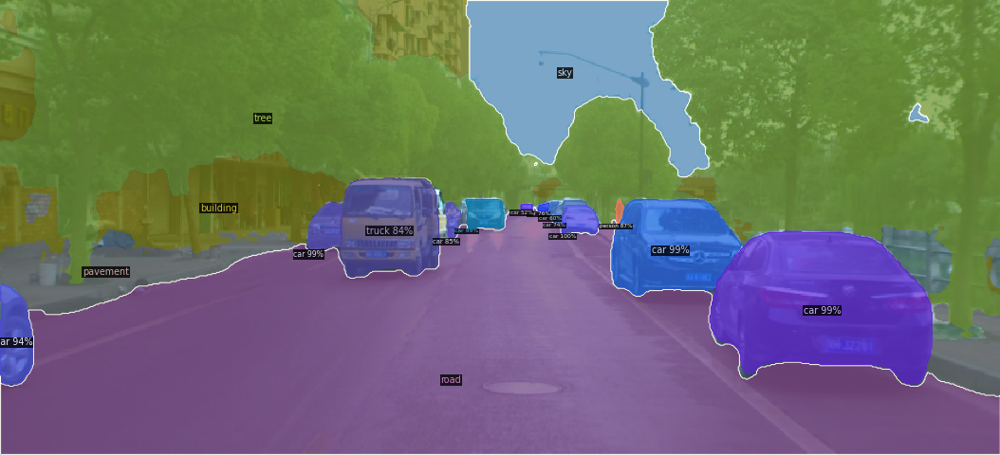

instance predictions


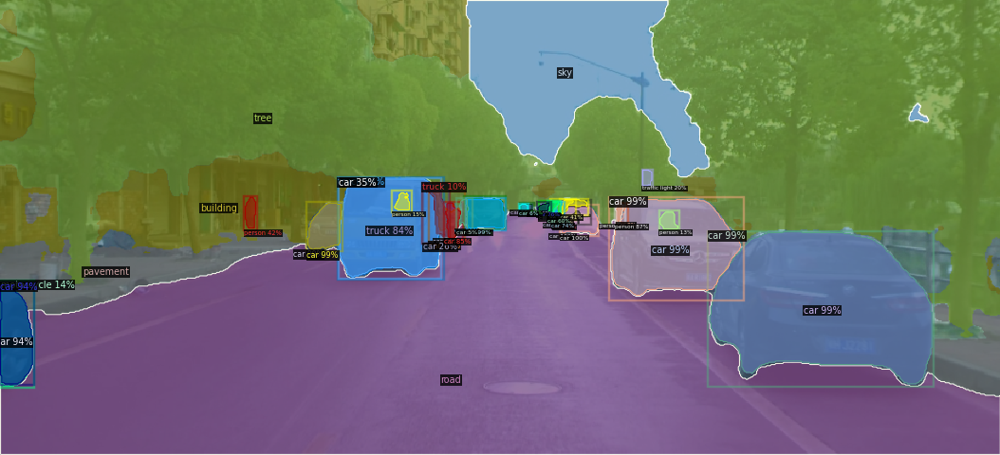

contour :  0
mask


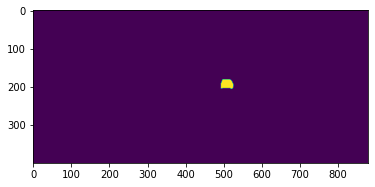

contour :  1
mask


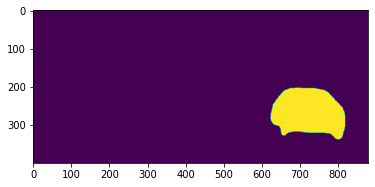

contour :  2
mask


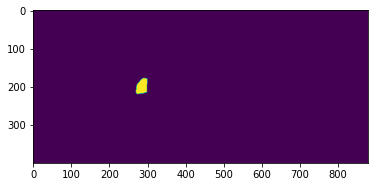

contour :  3
mask


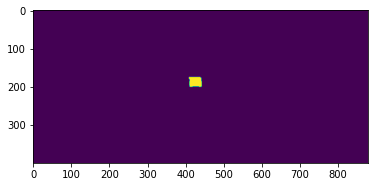

contour :  4
mask


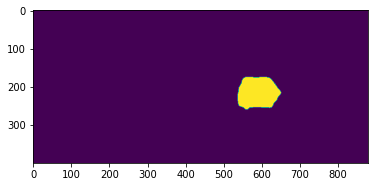

contour :  5
mask


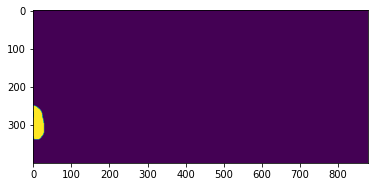

contour :  6
mask


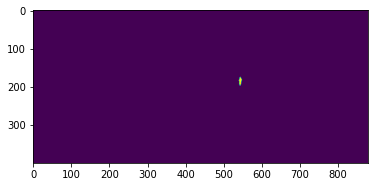

contour :  7
mask


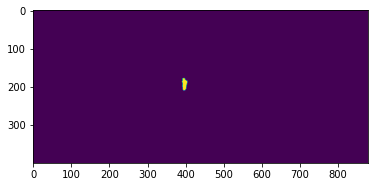

contour :  8
mask


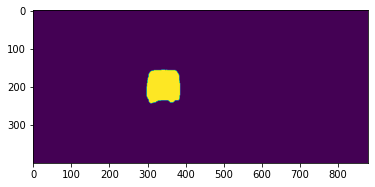

contour :  9
mask


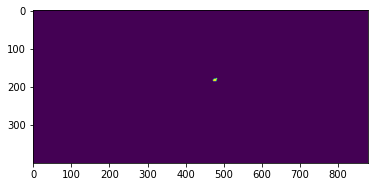

contour :  10
mask


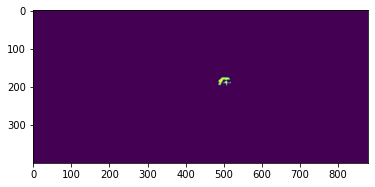

contour :  11
mask


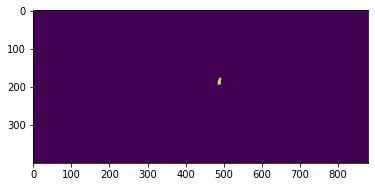

contour :  12
mask


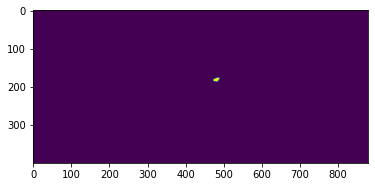

contour :  13
mask


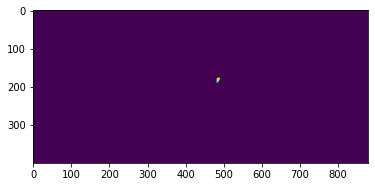

contour :  14
mask


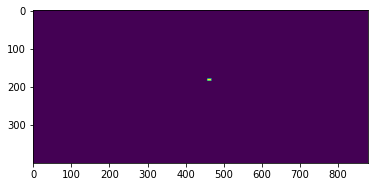

contour :  15
mask


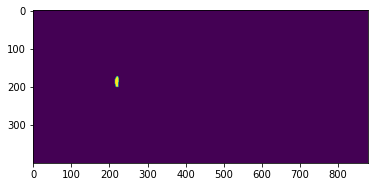

contour :  16
mask


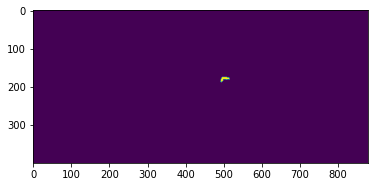

contour :  17
mask


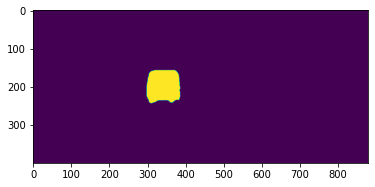

contour :  18
mask


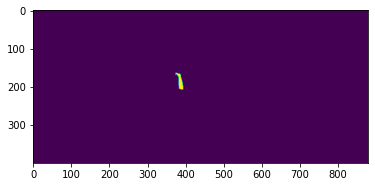

contour :  19
mask


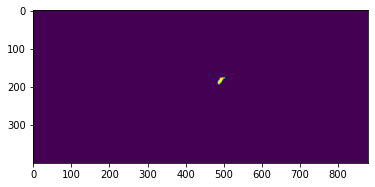

contour :  20
mask


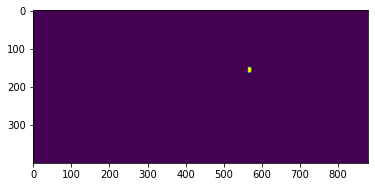

contour :  21
mask


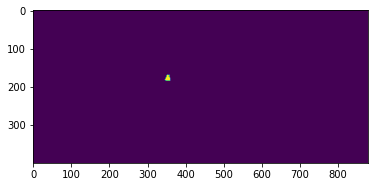

contour :  22
mask


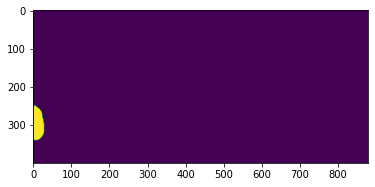

contour :  23
mask


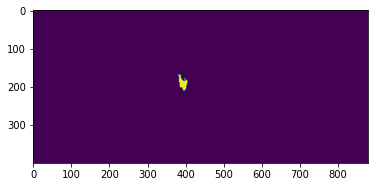

contour :  24
mask


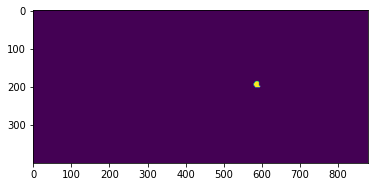

contour :  25
mask


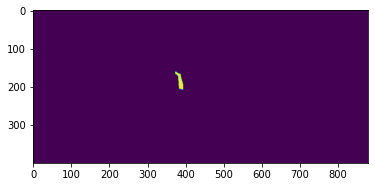

contour :  26
mask


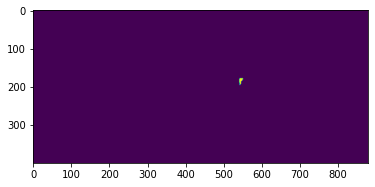

contour :  27
mask


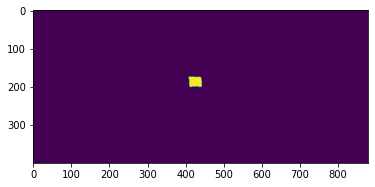

contour :  28
mask


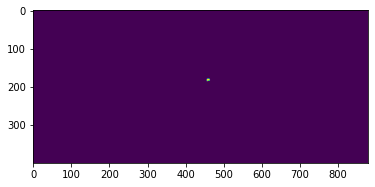

contour :  29
mask


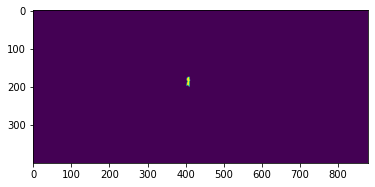

Enter countour ID8
contour :  0
contour :  1
contour :  2
contour :  3
contour :  4
contour :  5
contour :  6
contour :  7
contour :  8
contour :  9
contour :  10
contour :  11
contour :  12
contour :  13
contour :  14
contour :  15
contour :  16
contour :  17
contour :  18
contour :  19
contour :  20
contour :  21
contour :  22
contour :  23
contour :  24
contour :  25
contour :  26
contour :  27
contour :  28
contour :  29


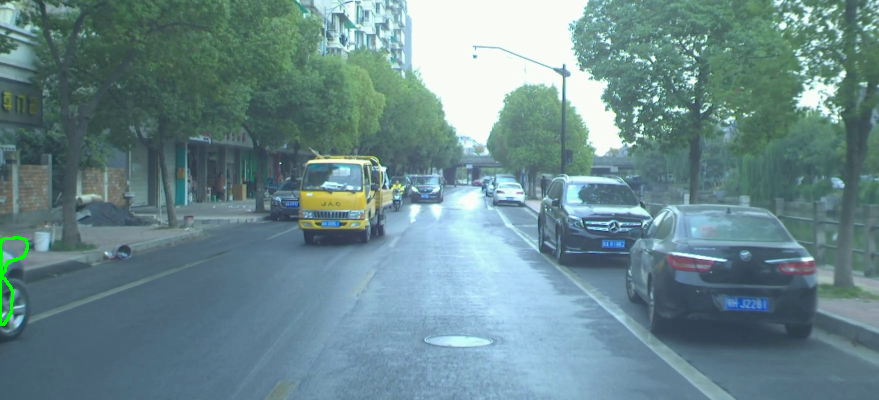

image_3_2018-10-31-06-55-01_2018-10-31-07-00-51-229.jpg
boundaries


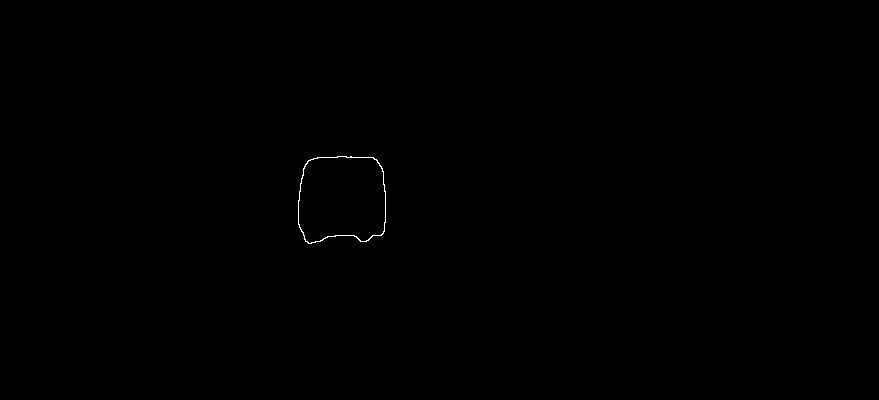

chain code of mask :  0000000000000000000000007007070770070007067766656665666656556565666666656666666666666666676777776666665655555666666665545444444445444444444444444444444444444444430
boundary length :  163
image_4_2018-10-31-06-55-01_2018-10-31-07-00-51-529.jpg


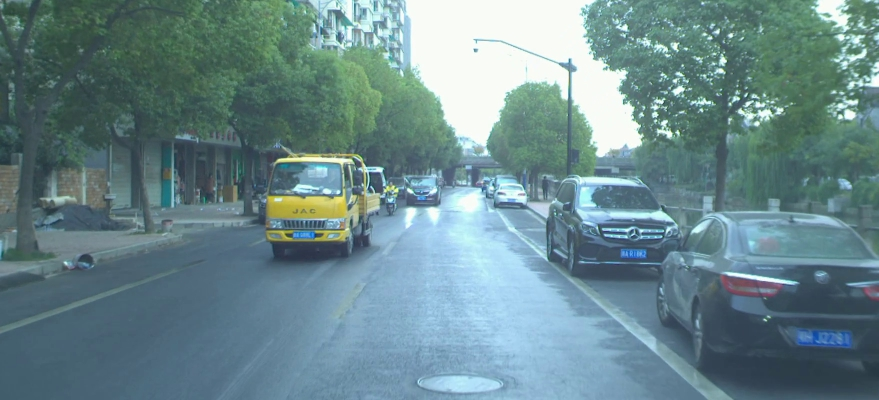

panoptic segmentations


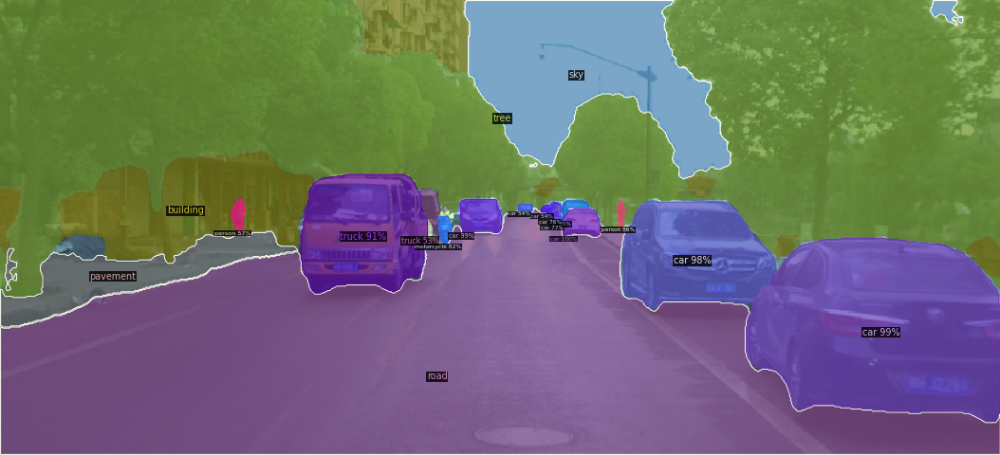

instance predictions


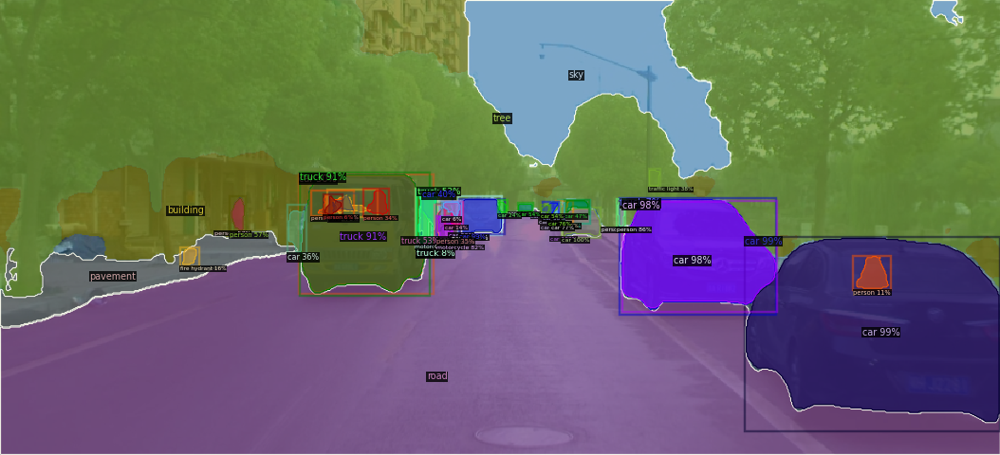

contour :  0
mask


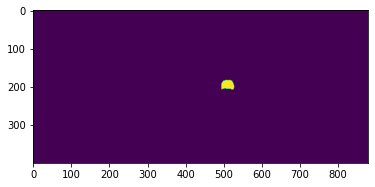

contour :  1
mask


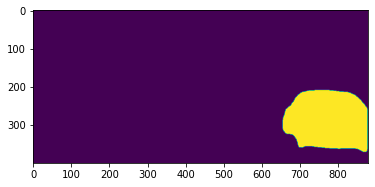

contour :  2
mask


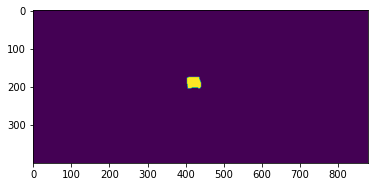

contour :  3
mask


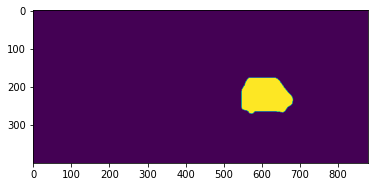

contour :  4
mask


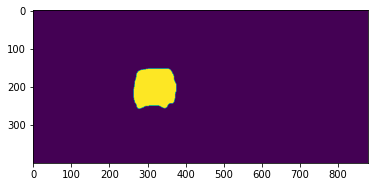

contour :  5
mask


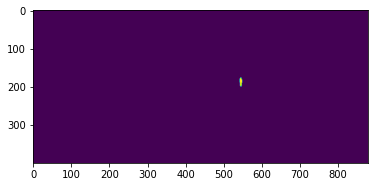

contour :  6
mask


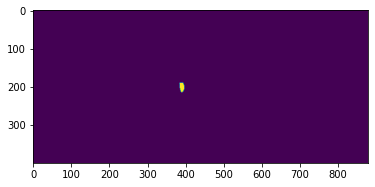

contour :  7
mask


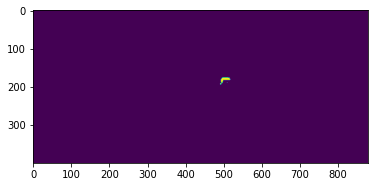

contour :  8
mask


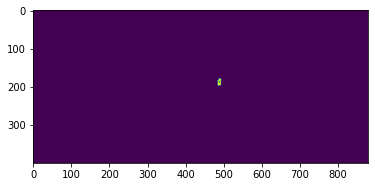

contour :  9
mask


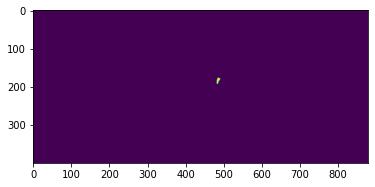

contour :  10
mask


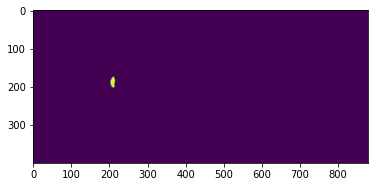

contour :  11
mask


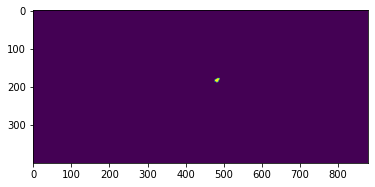

contour :  12
mask


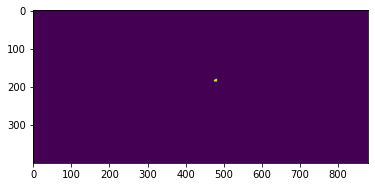

contour :  13
mask


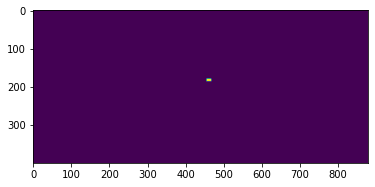

contour :  14
mask


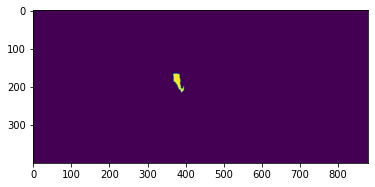

contour :  15
mask


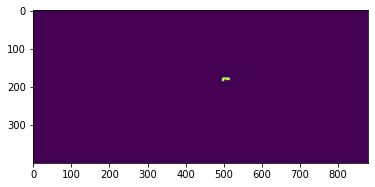

contour :  16
mask


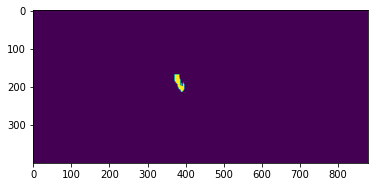

contour :  17
mask


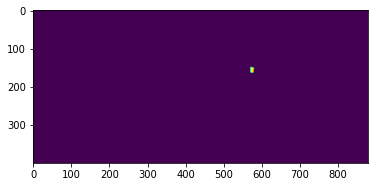

contour :  18
mask


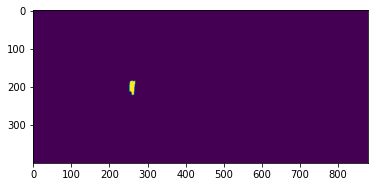

contour :  19
mask


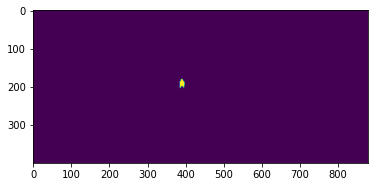

contour :  20
mask


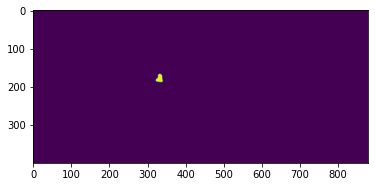

contour :  21
mask


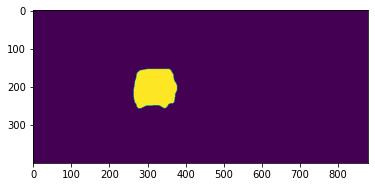

contour :  22
mask


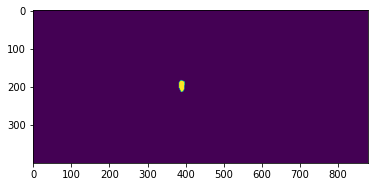

contour :  23
mask


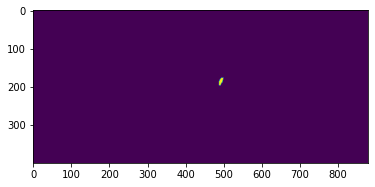

contour :  24
mask


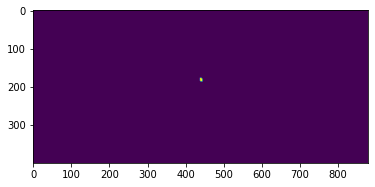

contour :  25
mask


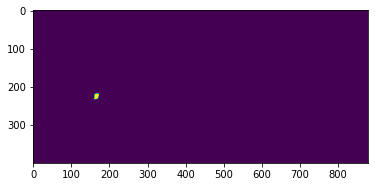

contour :  26
mask


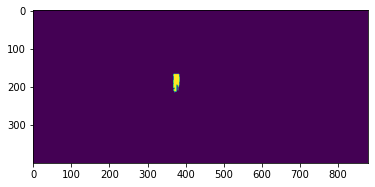

contour :  27
mask


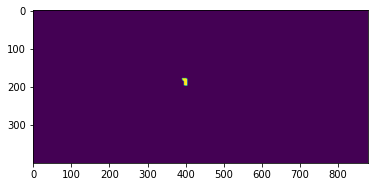

contour :  28
mask


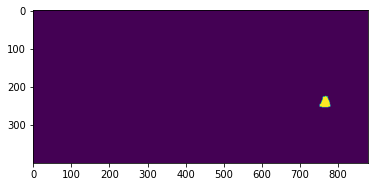

contour :  29
mask


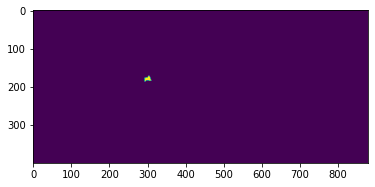

contour :  30
mask


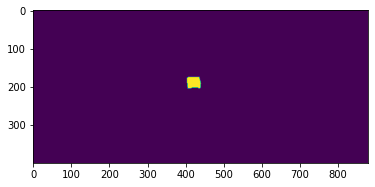

contour :  31
mask


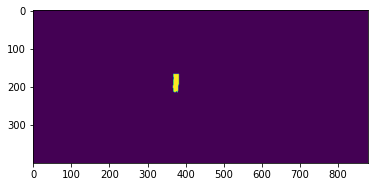

contour :  32
mask


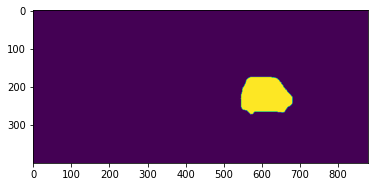

contour :  33
mask


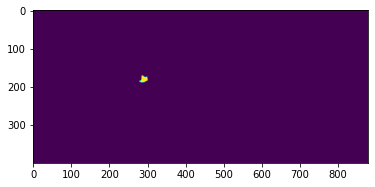

contour :  34
mask


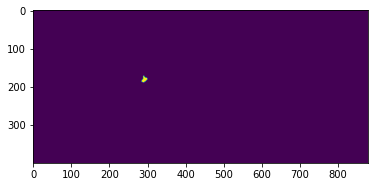

contour :  35
mask


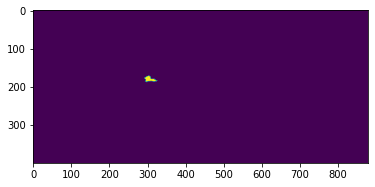

contour :  36
mask


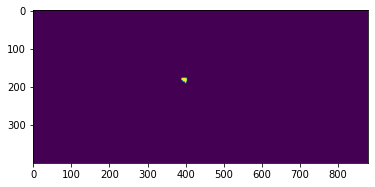

contour :  37
mask


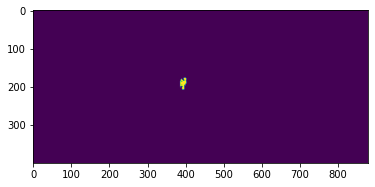

Enter countour ID4
contour :  0
contour :  1
contour :  2
contour :  3
contour :  4
contour :  5
contour :  6
contour :  7
contour :  8
contour :  9
contour :  10
contour :  11
contour :  12
contour :  13
contour :  14
contour :  15
contour :  16
contour :  17
contour :  18
contour :  19
contour :  20
contour :  21
contour :  22
contour :  23
contour :  24
contour :  25
contour :  26
contour :  27
contour :  28
contour :  29
contour :  30
contour :  31
contour :  32
contour :  33
contour :  34
contour :  35
contour :  36
contour :  37


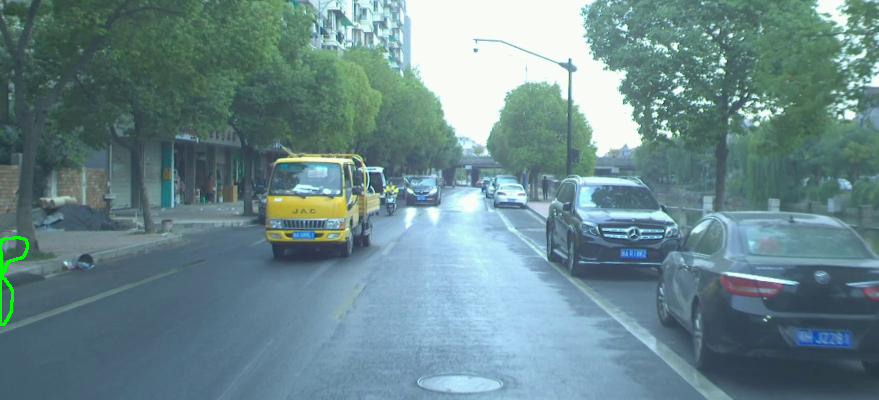

image_4_2018-10-31-06-55-01_2018-10-31-07-00-51-529.jpg
boundaries


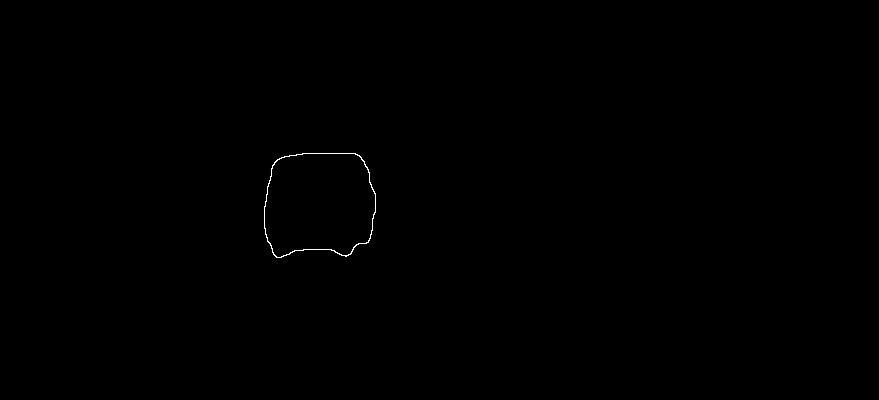

chain code of mask :  00000000000000000000007000007007000777070070007077766666565665665565656666666656666666666666666666666666676677676767666765656545454555565666666656454544454445444444444445444545444444444444444444430
boundary length :  197
image_5_2018-10-31-06-55-01_2018-10-31-07-00-51-729.jpg


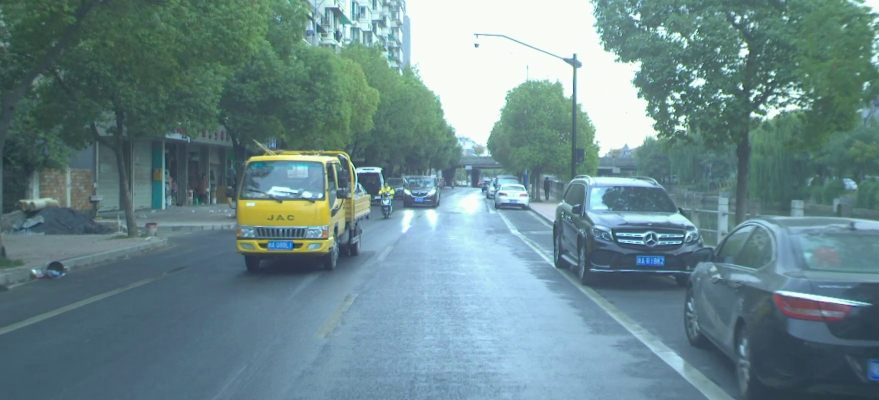

panoptic segmentations


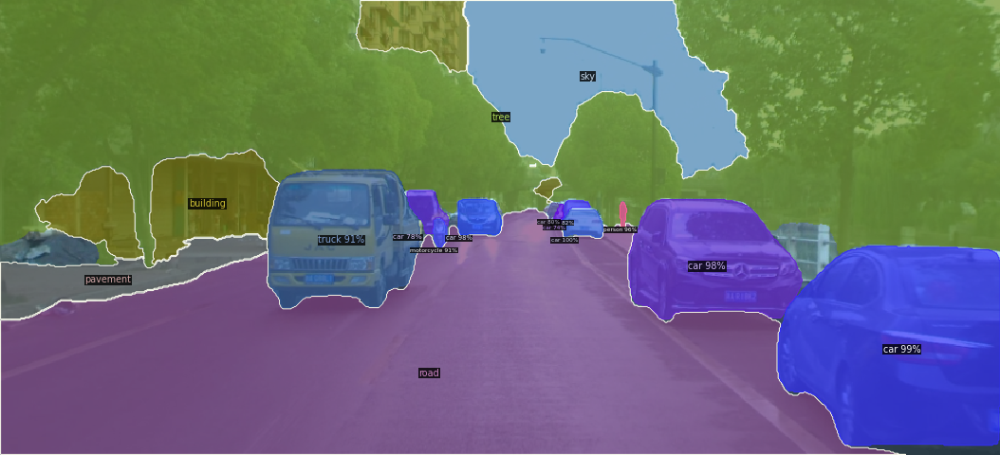

instance predictions


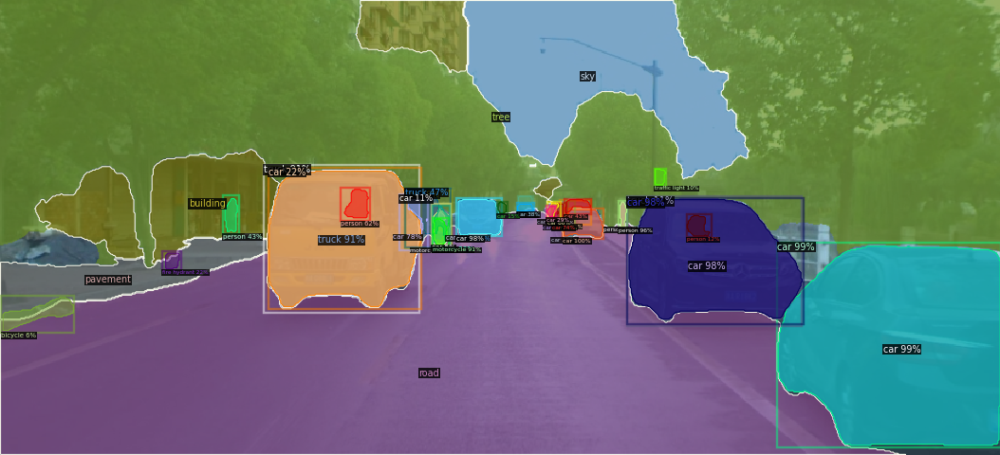

contour :  0
mask


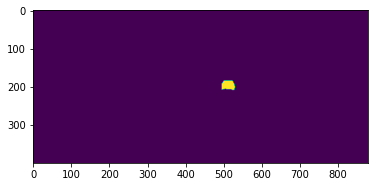

contour :  1
mask


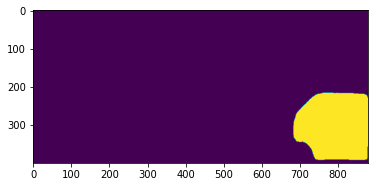

contour :  2
mask


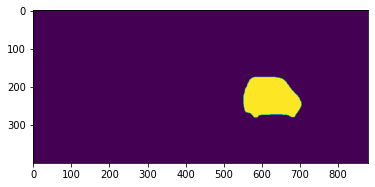

contour :  3
mask


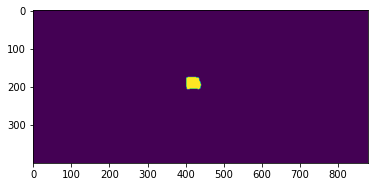

contour :  4
mask


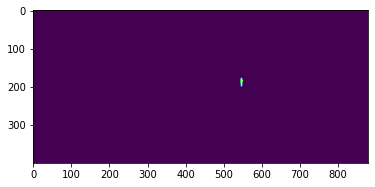

contour :  5
mask


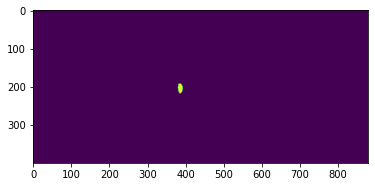

contour :  6
mask


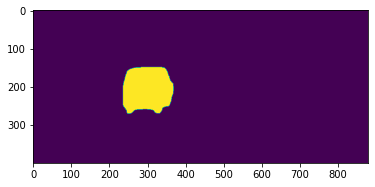

contour :  7
mask


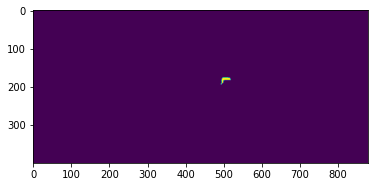

contour :  8
mask


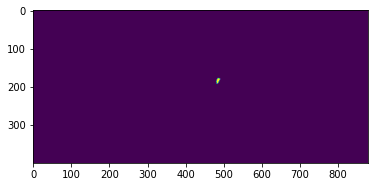

contour :  9
mask


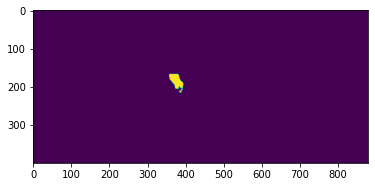

contour :  10
mask


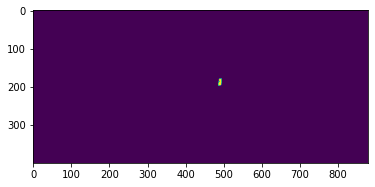

contour :  11
mask


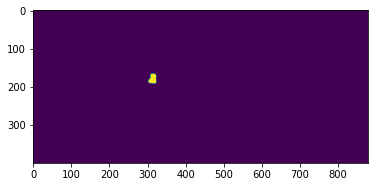

contour :  12
mask


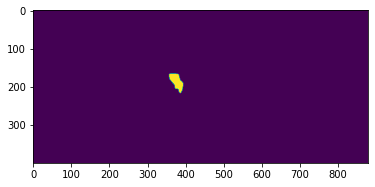

contour :  13
mask


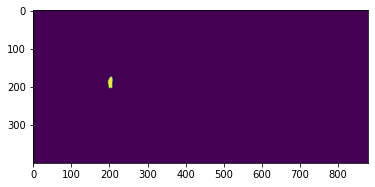

contour :  14
mask


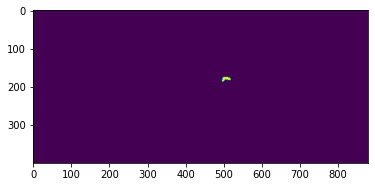

contour :  15
mask


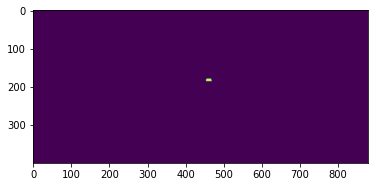

contour :  16
mask


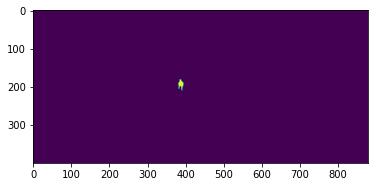

contour :  17
mask


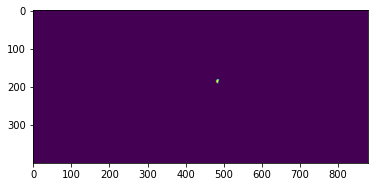

contour :  18
mask


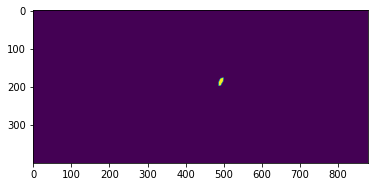

contour :  19
mask


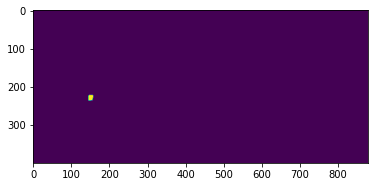

contour :  20
mask


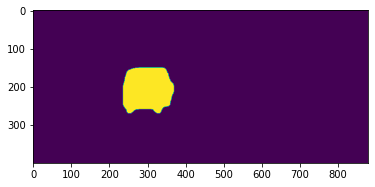

contour :  21
mask


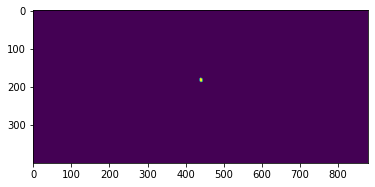

contour :  22
mask


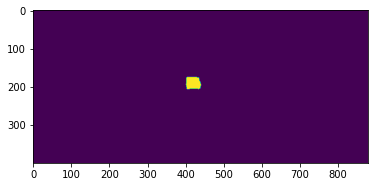

contour :  23
mask


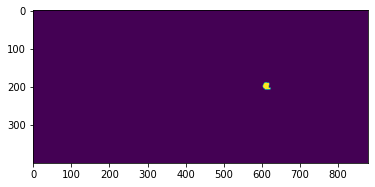

contour :  24
mask


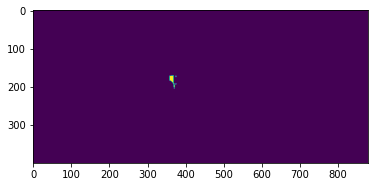

contour :  25
mask


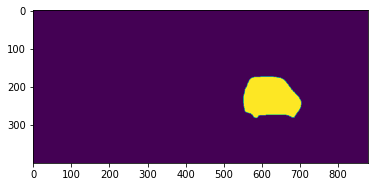

contour :  26
mask


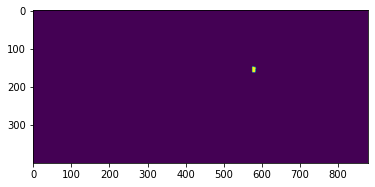

contour :  27
mask


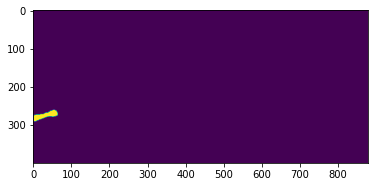

contour :  28
mask


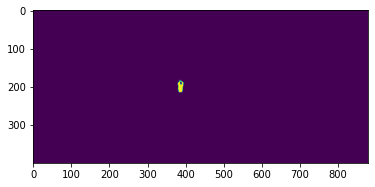

contour :  29
mask


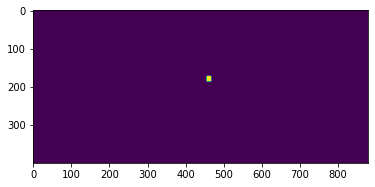

Enter countour ID6
contour :  0
contour :  1
contour :  2
contour :  3
contour :  4
contour :  5
contour :  6
contour :  7
contour :  8
contour :  9
contour :  10
contour :  11
contour :  12
contour :  13
contour :  14
contour :  15
contour :  16
contour :  17
contour :  18
contour :  19
contour :  20
contour :  21
contour :  22
contour :  23
contour :  24
contour :  25
contour :  26
contour :  27
contour :  28
contour :  29


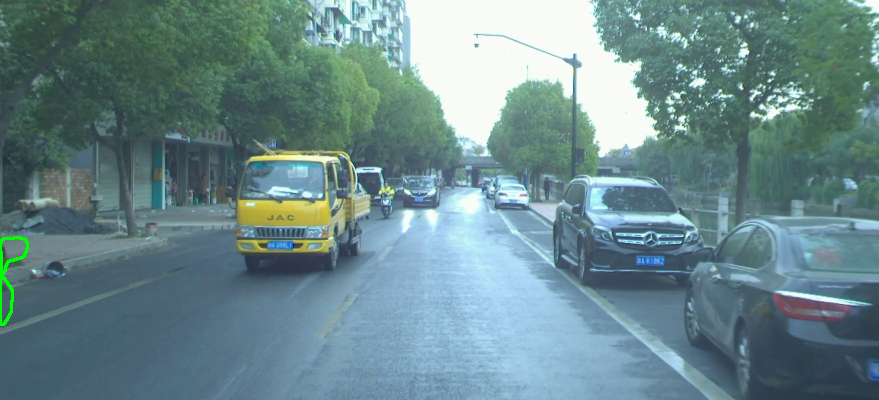

image_5_2018-10-31-06-55-01_2018-10-31-07-00-51-729.jpg
boundaries


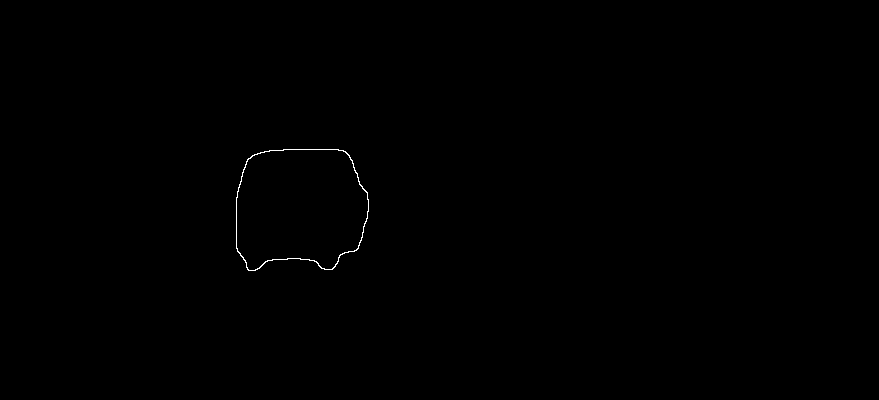

chain code of mask :  0000000000000000000000000000000000000000000000000007007770777077070000707666666656565555555656666566666666666666566666666666766666666766667677707776676666666655545545444545565656665666665655445445454454444544444544545445444444544444444444430
boundary length :  241
image_1_2018-10-31-06-55-01_2018-10-31-07-00-50-232.jpg
chain code :  0000000000000000000000070000070077566656566566566656666666666676666707666665665644544444444545454544544444444443034430
boundary length :  118
image_2_2018-10-31-06-55-01_2018-10-31-07-00-50-730.jpg
chain code :  0000000000000000000000000070700700007007666666655655565666656666666666666666666767777766566556665645444444445454565565454544444444444430
boundary length :  136
image_3_2018-10-31-06-55-01_2018-10-31-07-00-51-229.jpg
chain code :  0000000000000000000000007007070770070007067766656665666656556565666666656666666666666666676777776666665655555666666665545444444445444444444444444444444444444444430
boundary length :  163
image_4_2018-1

In [47]:
# Performing the same algorithm for several (5) images and comparing the chain code and boundary length (aka the order).

image_paths = ['image_1_2018-10-31-06-55-01_2018-10-31-07-00-50-232.jpg', 'image_2_2018-10-31-06-55-01_2018-10-31-07-00-50-730.jpg', 'image_3_2018-10-31-06-55-01_2018-10-31-07-00-51-229.jpg', 'image_4_2018-10-31-06-55-01_2018-10-31-07-00-51-529.jpg', 'image_5_2018-10-31-06-55-01_2018-10-31-07-00-51-729.jpg']
chain_codes = []

for path in image_paths:
  print(path)
  _image = cv2.imread(path)
  cv2_imshow(_image)

  panoptic_and_instance_segmentation(_image)
  
  get_countours(_image, True)
  contour_id = int(input('Enter countour ID'))

  _mask = get_mask_at_i(_image, contour_id)

  se = numpy.ones((3, 3), dtype=numpy.uint8)
  _eroded_mask = cv2.erode(_mask, se)

  _boundaries = _mask - _eroded_mask
  
  print(path)
  print('boundaries')
  cv2_imshow(_boundaries)


  print('chain code of mask : ', chain_code_8n(_boundaries, get_start_point(_boundaries)))
  print('boundary length : ', len(chain_code_8n(_boundaries, get_start_point(_boundaries))))

  chain_codes.append(chain_code_8n(_boundaries, get_start_point(_boundaries)))

i = 0
for path in image_paths:
  print(path)
  print('chain code : ', chain_codes[i])
  print('boundary length : ', len(chain_codes[i]))
  i += 1
  

In [48]:
i = 0
for path in image_paths:
  print(path)
  print('chain code : ', chain_codes[i])
  print('boundary length : ', len(chain_codes[i]))
  i += 1
  

image_1_2018-10-31-06-55-01_2018-10-31-07-00-50-232.jpg
chain code :  0000000000000000000000070000070077566656566566566656666666666676666707666665665644544444444545454544544444444443034430
boundary length :  118
image_2_2018-10-31-06-55-01_2018-10-31-07-00-50-730.jpg
chain code :  0000000000000000000000000070700700007007666666655655565666656666666666666666666767777766566556665645444444445454565565454544444444444430
boundary length :  136
image_3_2018-10-31-06-55-01_2018-10-31-07-00-51-229.jpg
chain code :  0000000000000000000000007007070770070007067766656665666656556565666666656666666666666666676777776666665655555666666665545444444445444444444444444444444444444444430
boundary length :  163
image_4_2018-10-31-06-55-01_2018-10-31-07-00-51-529.jpg
chain code :  00000000000000000000007000007007000777070070007077766666565665665565656666666656666666666666666666666666676677676767666765656545454555565666666656454544454445444444444445444545444444444444444444430
boundary length :  197
image_5_20